# Visit with Us: Travel Package Purchase Prediction
_Ensemble Techniques - Boosting_

__Joseph Reves joe.reves@gmail.com__

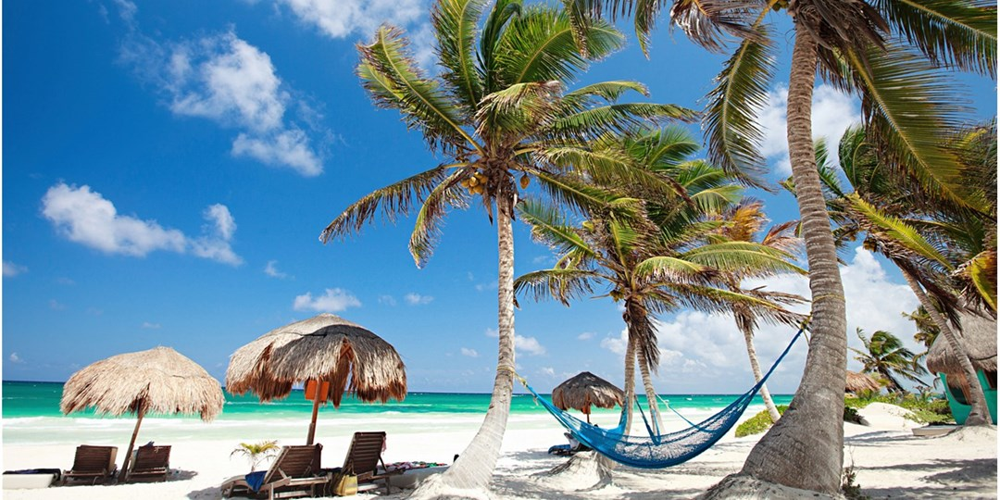

## Context and Objectives:

You are a Data Scientist for a tourism company named "Visit with us". The Policy Maker of the company wants to enable and establish a viable business model to expand the customer base.

A viable business model is a central concept that helps you to understand the existing ways of doing the business and how to change the ways for the benefit of the tourism sector.

One of the ways to expand the customer base is to introduce a new offering of packages.

Currently, there are 5 types of packages the company is offering - Basic, Standard, Deluxe, Super Deluxe, King. Looking at the data of the last year, we observed that 18% of the customers purchased the packages.

However, it was difficult to identify the potential customers because customers were contacted at random without looking at the available information.


The company is now planning to launch a new product i.e. Wellness Tourism Package. Wellness Tourism is defined as Travel that allows the traveler to maintain, enhance or kick-start a healthy lifestyle, and support or increase one's sense of well-being.

This time company wants to harness the available data of existing and potential customers to target the right customers.

You as a Data Scientist at "Visit with us" travel company has to analyze the customers' data and information to provide recommendations to the Policy Maker and build a model to predict the potential customer who is going to purchase the newly introduced travel package. The model will be built to make predictions before a customer is contacted.

__Objective__
* Predict which customers are more likely to purchase the newly introduced travel package.

__Data Dictionary__

_Customer details_
* CustomerID: Unique customer ID
* ProdTaken: Whether the customer has purchased a package or not (0: No, 1: Yes)
* Age: Age of customer
* TypeofContact: How customer was contacted (Company Invited or Self Inquiry)
* CityTier: City tier depends on the development of a city, population, facilities, and living standards. The categories are ordered i.e. Tier 1 > Tier 2 > Tier 3. It's the city the customer lives in.
* Occupation: Occupation of customer
* Gender: Gender of customer
* NumberOfPersonVisiting: Total number of persons planning to take the trip with the customer
* PreferredPropertyStar: Preferred hotel property rating by customer
* MaritalStatus: Marital status of customer
* NumberOfTrips: Average number of trips in a year by customer
* Passport: The customer has a passport or not (0: No, 1: Yes)
* OwnCar: Whether the customers own a car or not (0: No, 1: Yes)
* NumberOfChildrenVisiting: Total number of children with age less than 5 planning to take the trip with the customer
* Designation: Designation of the customer in the current organization
* MonthlyIncome: Gross monthly income of the customer

_Customer Interaction data_
* PitchSatisfactionScore: Sales pitch satisfaction score
* ProductPitched: Product pitched by the salesperson
* NumberOfFollowups: Total number of follow-ups has been done by the salesperson after the sales pitch
* DurationOfPitch: Duration of the pitch by a salesperson to the customer

### Assignment Objectives

__Exploratory Data Analysis__
* Univariate analysis - Key meaningful observations on individual variables and the relationship between variables
* Bivariate analysis - Use appropriate visualizations to identify the patterns and insights
* Customer Profiling - Create profiles of the customers who purchased a package.
  * Each of the 5 packages should be profiled - Basic, Standard, Deluxe, Super Deluxe, and King 
  * Provide at least 3 points to distinguish features for each package 

__Data Pre-processing__
* Missing value Treatment
* Outlier Detection(treat, if needed- why or why not )
* Feature Engineering
* Prepare data for modeling

__Model Building: Bagging__
* Build Bagging classifier, Random Forest, and Decision Tree
* Comment on model performance

__Model Performance Improvement: Bagging__
* Identify the appropriate metric for model performance evaluation and why
* Comment on the model performance after tuning the Decision Tree, Bagging, and Random Forest classifiers

__Model Building: Boosting__
* Build Adaboost, GradientBoost, XGBoost, and Stacking classifiers
* Comment on model performance

__Model Performance Improvement: Boosting__
* Identify the appropriate metric for model performance evaluation and why
* Comment on the model performance after tuning the AdaBoost, and Gradient Boosting classifiers 
  * _Please note XGBoost can take a significantly longer time to run, so if you have time complexity issues then you can avoid tuning XGBoost_

__Actionable Insights & Recommendations__
* Compare model performance on various metrics
* Conclude with the key takeaways - What would your advice be to grow the business?

__Notebook - Overall__
* Structure and flow
* Well commented code

## Importing Necessary Libraries

In [1]:
# this will help in making the Python code more structured automatically (good coding practice)
%load_ext nb_black

# Supress and filter unecessary warning messages
import warnings

warnings.filterwarnings("ignore")

# Libraries to help with reading and manipulating data
import pandas as pd
import numpy as np

# useful utilities
import pandas_profiling

# libaries to help with data visualization
import seaborn as sns
import matplotlib.pyplot as plt

%matplotlib inline

# To build models for prediction

from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import (
    f1_score,
    accuracy_score,
    recall_score,
    precision_score,
    confusion_matrix,
    roc_auc_score,
    plot_confusion_matrix,
    precision_recall_curve,
    roc_curve,
    classification_report,
)
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier,StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier

# To install xgboost library use - !pip install xgboost
from xgboost import XGBClassifier


<IPython.core.display.Javascript object>

## Explore the characteristics of the data

<div class="alert alert-block alert-info">
<b>Dependency:</b> Loading the "Tourism.xlsx" file from the local directory where the notebook is stored. For this project, I'm using Anaconda on my local machine.
</div>

In [2]:
# Reading the Tourism dataset with the read_csv function from pandas package
travelers = pd.read_excel("Tourism.xlsx", sheet_name="Tourism")

<IPython.core.display.Javascript object>

In [3]:
# Let's make a copy while we explore the data, and potentially make some changes
tourism = travelers.copy()

<IPython.core.display.Javascript object>

In [4]:
# Quick look at a random sample of values in the data
tourism.sample(10)

,CustomerID,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Designation,MonthlyIncome
882,200882,0,36.0,Self Enquiry,1,6.0,Large Business,Female,3,5.0,Standard,5.0,Married,3.0,1,2,1,2.0,Senior Manager,25252.0
23,200023,0,21.0,Self Enquiry,1,21.0,Salaried,Male,3,3.0,Basic,3.0,Single,2.0,0,3,1,1.0,Executive,16232.0
3243,203243,0,43.0,Self Enquiry,1,9.0,Small Business,Male,3,4.0,Super Deluxe,5.0,Divorced,NaN,0,3,1,2.0,AVP,36343.0
3478,203478,0,46.0,Self Enquiry,1,27.0,Small Business,Male,4,6.0,Standard,5.0,Married,4.0,1,3,0,1.0,Senior Manager,29529.0
2392,202392,1,44.0,Self Enquiry,3,15.0,Salaried,Male,3,4.0,Basic,5.0,Married,4.0,0,1,1,2.0,Executive,34190.0
2346,202346,0,20.0,Self Enquiry,3,27.0,Small Business,Male,2,1.0,Basic,3.0,Single,2.0,0,3,1,1.0,Executive,17678.0
1279,201279,1,44.0,Company Invited,1,6.0,Small Business,Male,2,3.0,Basic,4.0,Married,2.0,1,3,1,1.0,Executive,17342.0
1513,201513,0,27.0,Company Invited,3,14.0,Salaried,Male,2,3.0,Standard,3.0,Unmarried,2.0,0,1,1,0.0,Senior Manager,23726.0
1771,201771,0,18.0,Self Enquiry,3,16.0,Small Business,Female,3,4.0,Basic,3.0,Single,2.0,0,1,0,2.0,Executive,16200.0
3010,203010,1,48.0,Company Invited,3,34.0,Salaried,Fe Male,4,2.0,Deluxe,3.0,Unmarried,6.0,1,4,1,3.0,Manager,25075.0


<IPython.core.display.Javascript object>

In [5]:
# What's the size and shape of the data?
print(
    "The available data includes",
    tourism.shape[0],
    "rows, with",
    tourism.shape[1],
    "columns of information",
)

The available data includes 4888 rows, with 20 columns of information


<IPython.core.display.Javascript object>

In [6]:
# How is the data currently typed by python?
tourism.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4888 entries, 0 to 4887
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CustomerID                4888 non-null   int64  
 1   ProdTaken                 4888 non-null   int64  
 2   Age                       4662 non-null   float64
 3   TypeofContact             4863 non-null   object 
 4   CityTier                  4888 non-null   int64  
 5   DurationOfPitch           4637 non-null   float64
 6   Occupation                4888 non-null   object 
 7   Gender                    4888 non-null   object 
 8   NumberOfPersonVisiting    4888 non-null   int64  
 9   NumberOfFollowups         4843 non-null   float64
 10  ProductPitched            4888 non-null   object 
 11  PreferredPropertyStar     4862 non-null   float64
 12  MaritalStatus             4888 non-null   object 
 13  NumberOfTrips             4748 non-null   float64
 14  Passport

<IPython.core.display.Javascript object>

In [7]:
# check for null values in the data
tourism.isnull().sum()

CustomerID                    0
ProdTaken                     0
Age                         226
TypeofContact                25
CityTier                      0
DurationOfPitch             251
Occupation                    0
Gender                        0
NumberOfPersonVisiting        0
NumberOfFollowups            45
ProductPitched                0
PreferredPropertyStar        26
MaritalStatus                 0
NumberOfTrips               140
Passport                      0
PitchSatisfactionScore        0
OwnCar                        0
NumberOfChildrenVisiting     66
Designation                   0
MonthlyIncome               233
dtype: int64

<IPython.core.display.Javascript object>

In [8]:
# describe the object variables
tourism.describe(include="object").T

,count,unique,top,freq
TypeofContact,4863,2,Self Enquiry,3444
Occupation,4888,4,Salaried,2368
Gender,4888,3,Male,2916
ProductPitched,4888,5,Basic,1842
MaritalStatus,4888,4,Married,2340
Designation,4888,5,Executive,1842


<IPython.core.display.Javascript object>

In [9]:
# describe the numeric variables
tourism.describe(exclude="object").T

,count,mean,std,min,25%,50%,75%,max
CustomerID,4888.0,202443.500000,1411.188388,200000.0,201221.75,202443.5,203665.25,204887.0
ProdTaken,4888.0,0.188216,0.390925,0.0,0.00,0.0,0.00,1.0
Age,4662.0,37.622265,9.316387,18.0,31.00,36.0,44.00,61.0
CityTier,4888.0,1.654255,0.916583,1.0,1.00,1.0,3.00,3.0
DurationOfPitch,4637.0,15.490835,8.519643,5.0,9.00,13.0,20.00,127.0
NumberOfPersonVisiting,4888.0,2.905074,0.724891,1.0,2.00,3.0,3.00,5.0
NumberOfFollowups,4843.0,3.708445,1.002509,1.0,3.00,4.0,4.00,6.0
PreferredPropertyStar,4862.0,3.581037,0.798009,3.0,3.00,3.0,4.00,5.0
NumberOfTrips,4748.0,3.236521,1.849019,1.0,2.00,3.0,4.00,22.0
Passport,4888.0,0.290917,0.454232,0.0,0.00,0.0,1.00,1.0


<IPython.core.display.Javascript object>

In [10]:
object_cols = tourism.select_dtypes(["object"])
object_cols.columns

Index(['TypeofContact', 'Occupation', 'Gender', 'ProductPitched',
       'MaritalStatus', 'Designation'],
      dtype='object')

<IPython.core.display.Javascript object>

In [11]:
columns = tourism.columns
print(columns)

Index(['CustomerID', 'ProdTaken', 'Age', 'TypeofContact', 'CityTier',
       'DurationOfPitch', 'Occupation', 'Gender', 'NumberOfPersonVisiting',
       'NumberOfFollowups', 'ProductPitched', 'PreferredPropertyStar',
       'MaritalStatus', 'NumberOfTrips', 'Passport', 'PitchSatisfactionScore',
       'OwnCar', 'NumberOfChildrenVisiting', 'Designation', 'MonthlyIncome'],
      dtype='object')


<IPython.core.display.Javascript object>

In [12]:
# check our independent variables for duplicates
tourism[
    tourism.duplicated(
        subset=[
            "Age",
            "TypeofContact",
            "CityTier",
            "DurationOfPitch",
            "Occupation",
            "Gender",
            "NumberOfPersonVisiting",
            "NumberOfFollowups",
            "ProductPitched",
            "PreferredPropertyStar",
            "MaritalStatus",
            "NumberOfTrips",
            "Passport",
            "PitchSatisfactionScore",
            "OwnCar",
            "NumberOfChildrenVisiting",
            "Designation",
            "MonthlyIncome",
        ],
        keep=False,
    )
].sort_values(by=["MonthlyIncome"])

,CustomerID,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Designation,MonthlyIncome
1971,201971,0,30.0,Company Invited,1,9.0,Small Business,Female,3,3.0,Basic,3.0,Married,2.0,0,3,1,1.0,Executive,17083.0
501,200501,0,30.0,Company Invited,1,9.0,Small Business,Female,3,3.0,Basic,3.0,Married,2.0,0,3,1,1.0,Executive,17083.0
1642,201642,0,36.0,Company Invited,1,9.0,Small Business,Male,1,3.0,Basic,4.0,Single,5.0,0,4,1,0.0,Executive,17088.0
172,200172,0,36.0,Company Invited,1,9.0,Small Business,Male,1,3.0,Basic,4.0,Single,5.0,0,4,1,0.0,Executive,17088.0
1732,201732,0,32.0,Self Enquiry,1,8.0,Large Business,Male,2,4.0,Deluxe,5.0,Single,5.0,0,4,0,1.0,Manager,17176.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2093,202093,0,NaN,Company Invited,1,11.0,Salaried,Male,3,4.0,Basic,3.0,Married,1.0,0,5,0,0.0,Executive,NaN
2189,202189,0,NaN,Self Enquiry,3,10.0,Salaried,Female,2,3.0,Deluxe,3.0,Single,2.0,1,3,1,1.0,Manager,NaN
2195,202195,1,NaN,Self Enquiry,1,20.0,Salaried,Male,2,4.0,Basic,4.0,Married,2.0,1,5,1,1.0,Executive,NaN
2237,202237,0,NaN,Self Enquiry,1,9.0,Salaried,Female,2,3.0,Deluxe,4.0,Single,4.0,0,4,1,0.0,Manager,NaN


<IPython.core.display.Javascript object>

## Prepare the data for analysis

In [13]:
# Customer ID probably won't help us analyze the characteristics of target customers - we'll drop this column
tourism.drop("CustomerID", axis=1, inplace=True)

<IPython.core.display.Javascript object>

In [14]:
# Let's drop duplicate rows before we do any further cleanup, keeping the first unique row
tourism.drop_duplicates(
    subset=[
        "Age",
        "TypeofContact",
        "CityTier",
        "DurationOfPitch",
        "Occupation",
        "Gender",
        "NumberOfPersonVisiting",
        "NumberOfFollowups",
        "ProductPitched",
        "PreferredPropertyStar",
        "MaritalStatus",
        "NumberOfTrips",
        "Passport",
        "PitchSatisfactionScore",
        "OwnCar",
        "NumberOfChildrenVisiting",
        "Designation",
        "MonthlyIncome",
    ],
    keep="first",
    inplace=True,
)

<IPython.core.display.Javascript object>

In [15]:
# Convert our object types to categories
for i in object_cols.columns:
    tourism[i] = tourism[i].astype("category")

<IPython.core.display.Javascript object>

In [16]:
# Our non-duplicated nominal row count is now 4747 entries, and we still have a bunch of nulls to deal with
tourism.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4747 entries, 0 to 4887
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   ProdTaken                 4747 non-null   int64   
 1   Age                       4531 non-null   float64 
 2   TypeofContact             4722 non-null   category
 3   CityTier                  4747 non-null   int64   
 4   DurationOfPitch           4501 non-null   float64 
 5   Occupation                4747 non-null   category
 6   Gender                    4747 non-null   category
 7   NumberOfPersonVisiting    4747 non-null   int64   
 8   NumberOfFollowups         4703 non-null   float64 
 9   ProductPitched            4747 non-null   category
 10  PreferredPropertyStar     4721 non-null   float64 
 11  MaritalStatus             4747 non-null   category
 12  NumberOfTrips             4609 non-null   float64 
 13  Passport                  4747 non-null   int64 

<IPython.core.display.Javascript object>

* Memory usage is down substantially with the removal of dups and the coversion of objects to catagories

In [17]:
# Let's look at the unique values for our categories
for i in object_cols.columns:
    print("Unique values in", i, "are :")
    print(object_cols[i].value_counts())
    print("*" * 50)

Unique values in TypeofContact are :
Self Enquiry       3444
Company Invited    1419
Name: TypeofContact, dtype: int64
**************************************************
Unique values in Occupation are :
Salaried          2368
Small Business    2084
Large Business     434
Free Lancer          2
Name: Occupation, dtype: int64
**************************************************
Unique values in Gender are :
Male       2916
Female     1817
Fe Male     155
Name: Gender, dtype: int64
**************************************************
Unique values in ProductPitched are :
Basic           1842
Deluxe          1732
Standard         742
Super Deluxe     342
King             230
Name: ProductPitched, dtype: int64
**************************************************
Unique values in MaritalStatus are :
Married      2340
Divorced      950
Single        916
Unmarried     682
Name: MaritalStatus, dtype: int64
**************************************************
Unique values in Designation are :
Executiv

<IPython.core.display.Javascript object>

* Let's clean up the "Gender" issue

In [18]:
# correct the typos in the Gender column
tourism.loc[tourism["Gender"] == "Fe Male", "Gender"] = "Female"
print(tourism["Gender"].value_counts())

Male       2835
Female     1912
Fe Male       0
Name: Gender, dtype: int64


<IPython.core.display.Javascript object>

In [19]:
# Age is between 18 and 61; let's replace the missing values with the median
tourism["Age"] = tourism["Age"].fillna(tourism["Age"].median())

<IPython.core.display.Javascript object>

In [20]:
# We'll default TypeofContact to "Self Inquiry"
print(tourism["TypeofContact"].cat.categories)
tourism["TypeofContact"].fillna(
    tourism["TypeofContact"].cat.categories[1], inplace=True
)

Index(['Company Invited', 'Self Enquiry'], dtype='object')


<IPython.core.display.Javascript object>

In [21]:
# NumberofFollowups is between 1 and 6; let's replace the missing values with the median
tourism["NumberOfFollowups"] = tourism["NumberOfFollowups"].fillna(
    tourism["NumberOfFollowups"].median()
)

<IPython.core.display.Javascript object>

In [22]:
# PreferredPropertyStar is between 3 and 5; let's replace the missing values with the median
tourism["PreferredPropertyStar"] = tourism["PreferredPropertyStar"].fillna(
    tourism["PreferredPropertyStar"].median()
)

<IPython.core.display.Javascript object>

In [23]:
# NumberOfChildrenVisiting is between 0 and 3; let's replace the missing values with the median
tourism["NumberOfChildrenVisiting"] = tourism["NumberOfChildrenVisiting"].fillna(
    tourism["NumberOfChildrenVisiting"].median()
)

<IPython.core.display.Javascript object>

In [24]:
# MonthlyIncome is between $1K and $98K; let's replace the missing values with the median
tourism["MonthlyIncome"] = tourism["MonthlyIncome"].fillna(
    tourism["MonthlyIncome"].median()
)

<IPython.core.display.Javascript object>

* `DurationOfPitch` and `NumberOfTrips` both look like they may have outliers. I'll note that, but for our purposes, the classifiers we're using are not particularly sensitive to outliers, so we'll just clean up the missing values

In [25]:
# DurationOfPitch is between 5 and 127; let's replace the missing values with the median
tourism["DurationOfPitch"] = tourism["DurationOfPitch"].fillna(
    tourism["DurationOfPitch"].median()
)

<IPython.core.display.Javascript object>

In [26]:
# NumberOfTrips is between 1 and 22; let's replace the missing values with the median
tourism["NumberOfTrips"] = tourism["NumberOfTrips"].fillna(
    tourism["NumberOfTrips"].median()
)

<IPython.core.display.Javascript object>

In [27]:
tourism.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4747 entries, 0 to 4887
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   ProdTaken                 4747 non-null   int64   
 1   Age                       4747 non-null   float64 
 2   TypeofContact             4747 non-null   category
 3   CityTier                  4747 non-null   int64   
 4   DurationOfPitch           4747 non-null   float64 
 5   Occupation                4747 non-null   category
 6   Gender                    4747 non-null   category
 7   NumberOfPersonVisiting    4747 non-null   int64   
 8   NumberOfFollowups         4747 non-null   float64 
 9   ProductPitched            4747 non-null   category
 10  PreferredPropertyStar     4747 non-null   float64 
 11  MaritalStatus             4747 non-null   category
 12  NumberOfTrips             4747 non-null   float64 
 13  Passport                  4747 non-null   int64 

<IPython.core.display.Javascript object>

* __The initial data preparation is complete. I'll do the Univariate and Multivariate analysis with the categories, and generate dummy variables in the subsequent step__

* __Observations__
    * 141 rows of duplicate data dropped
    * CustomerID dropped - not useful for the analysis
    * Object variables converted to categorical, with the categories enumerated
    * Corrected a type in the Gender field, updated to the correct category
    * NaN values updated to median values for the variable
    * Null categories updated to the majority value
    * We have a complete dataset of 4747 non-duplicated rows

## Exploratory Data Analysis

#### Useful Functions

In [28]:
# Defining the function for creating boxplot and histogram
def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None, hue=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to show the density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots

    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="mediumturquoise"
    )  # boxplot will be created and a star will indicate the mean value of the column

    if (bins) and (hue):
        sns.histplot(
            data=data,
            x=feature,
            kde=kde,
            ax=ax_hist2,
            hue=hue,
            bins=bins,
            color="mediumpurple",
        )
    elif bins:
        sns.histplot(
            data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, color="mediumpurple"
        )
    elif hue:
        sns.histplot(
            data=data, x=feature, kde=kde, hue=hue, ax=ax_hist2, color="mediumpurple"
        )
    else:
        sns.histplot(
            data=data, x=feature, kde=kde, ax=ax_hist2, color="mediumpurple"
        )  # For histogram

    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram

    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram

<IPython.core.display.Javascript object>

In [29]:
# Let's use pandas profiling from y-data to explore the larger dataset
tourism.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

##### In addition to the details we'll find on individual variables in the profiling reports, let's also take a look at some of the interactions between variables here:

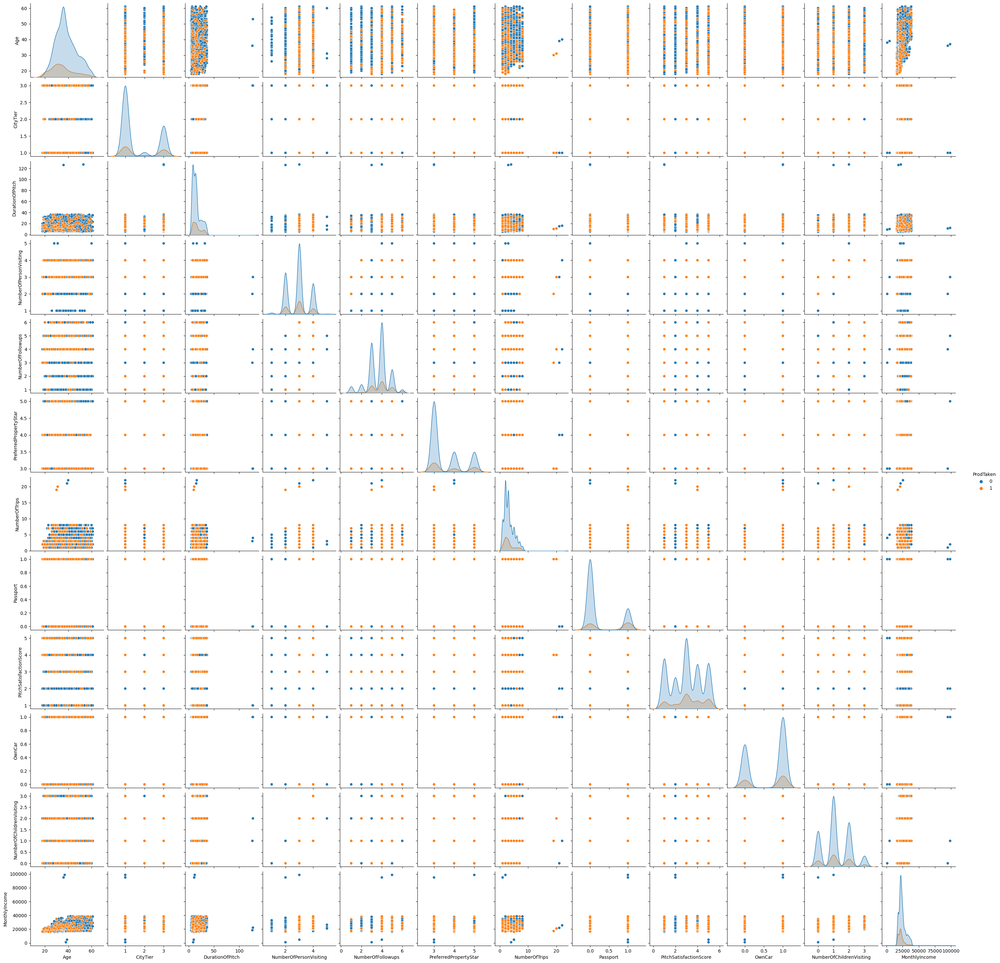

<IPython.core.display.Javascript object>

In [30]:
sns.pairplot(tourism, diag_kind="kde", hue="ProdTaken")
plt.show()

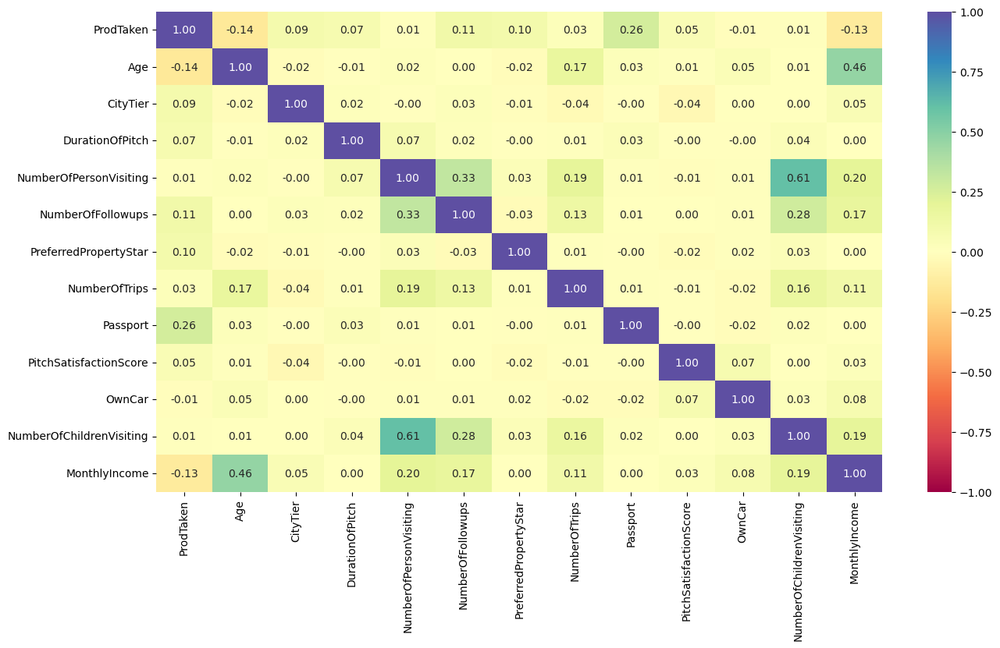

<IPython.core.display.Javascript object>

In [31]:
plt.figure(figsize=(15, 8))
sns.heatmap(tourism.corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral")
plt.show()

#### Observations

### Customer Profiles
<a id='profiles'></a>

For our customer profiles, we'll use a profile report for each segment of customer that actually purchased a travel package. We'll extract the data for customers who took the package, and which package they were pitched.  

We'll then examine the distribution of both packages that were purchased - and who purchased them - and, the customer designations of the purchasers - and what they purchased.

We'll also examine the distribution of these customer designations in both the group of customers that purchased, and in the larger group.

Finally, we'll dig into the data around unsuccessful pitch attempts - where we're spending time trying to sell a package, but we're not succeeding, and try to draw some conclusions about why.

Here are the links to the raw data analysis for each product segment, for reference.  We'll summarize conclusions below.

[Basic Travel Package](#basic)<br>
[Standard Travel Package](#standard)<br>
[Deluxe Travel Package](#deluxe)<br>
[Super Deluxe Travel Package](#super)<br>
[King Travel Package](#king)

In [32]:
# Let's create datasets from customers who were pitched a specific product, and purchased it
customers_basic = tourism.loc[
    (tourism["ProdTaken"] == 1) & (tourism["ProductPitched"] == "Basic")
]
customers_standard = tourism.loc[
    (tourism["ProdTaken"] == 1) & (tourism["ProductPitched"] == "Standard")
]
customers_deluxe = tourism.loc[
    (tourism["ProdTaken"] == 1) & (tourism["ProductPitched"] == "Deluxe")
]
customers_super = tourism.loc[
    (tourism["ProdTaken"] == 1) & (tourism["ProductPitched"] == "Super Deluxe")
]
customers_king = tourism.loc[
    (tourism["ProdTaken"] == 1) & (tourism["ProductPitched"] == "King")
]
# All customers who purchased a travel package
customers = tourism.loc[(tourism["ProdTaken"] == 1)]

# Unsuccessful product pitches - did not result in a sale
failed = tourism.loc[(tourism["ProdTaken"] == 0)]

<IPython.core.display.Javascript object>

__Visualize the breakdown of travel packages sold by count and percentage__

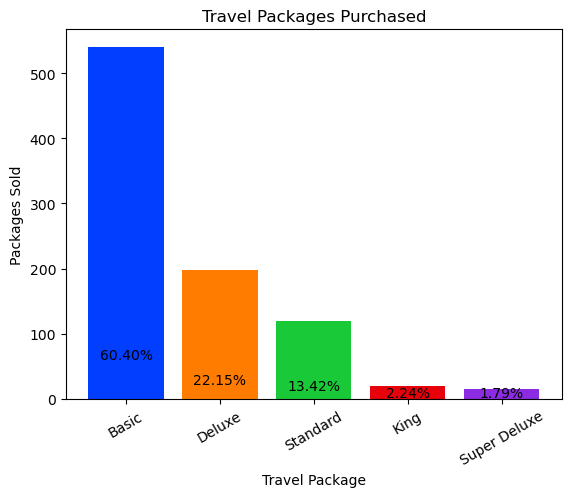

<IPython.core.display.Javascript object>

In [33]:
customers_count = (
    customers.groupby("ProductPitched")
    .size()
    .reset_index(name="count")
    .sort_values("count", ascending=False)
)

total_items = customers_count["count"].sum()
customers_count["percent"] = customers_count["count"] / total_items * 100

palette = sns.color_palette("bright", len(customers_count))

plt.bar(customers_count["ProductPitched"], customers_count["count"], color=palette)
plt.xticks(rotation=30)
plt.xlabel("Travel Package")
plt.ylabel("Packages Sold")
plt.title("Travel Packages Purchased")

# Add percentage labels to the bars
for i, val in enumerate(customers_count["percent"]):
    plt.text(i, val + 1, f"{val:.2f}%", ha="center")

plt.show()

<Figure size 800x600 with 0 Axes>

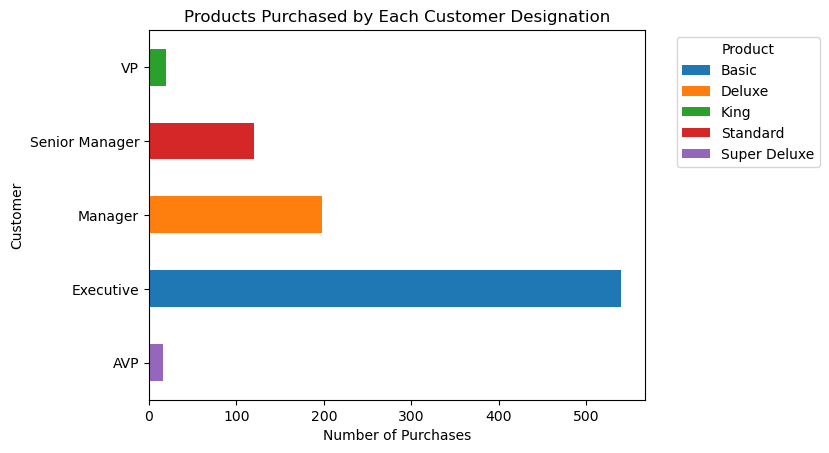

<Figure size 800x600 with 0 Axes>

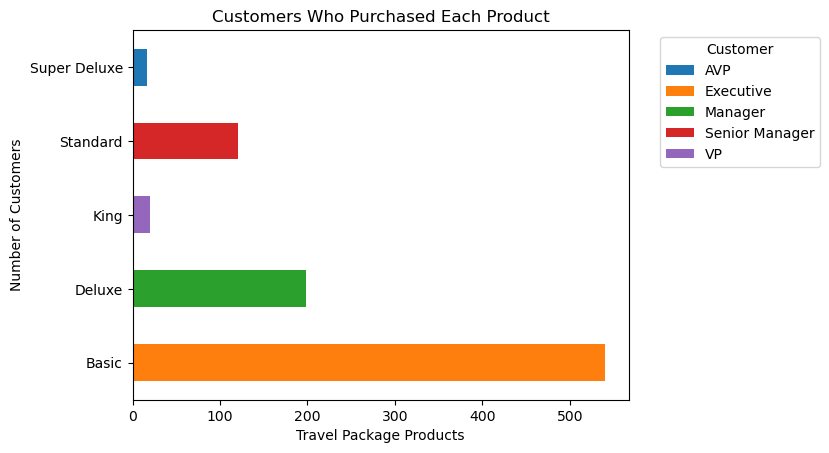

<IPython.core.display.Javascript object>

In [34]:
# create graph of Packages purchased by each customer
plt.figure(figsize=(8, 6))
customers.groupby(["Designation", "ProductPitched"]).size().unstack().plot(
    kind="barh", stacked=True
)
plt.xlabel("Number of Purchases")
plt.ylabel("Customer")
plt.title("Products Purchased by Each Customer Designation")
plt.legend(title="Product", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.show()

# create graph of customers who purchased each product
plt.figure(figsize=(8, 6))
customers.groupby(["ProductPitched", "Designation"]).size().unstack().plot(
    kind="barh", stacked=True
)
plt.xlabel("Travel Package Products")
plt.ylabel("Number of Customers")
plt.title("Customers Who Purchased Each Product")
plt.legend(title="Customer", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.show()


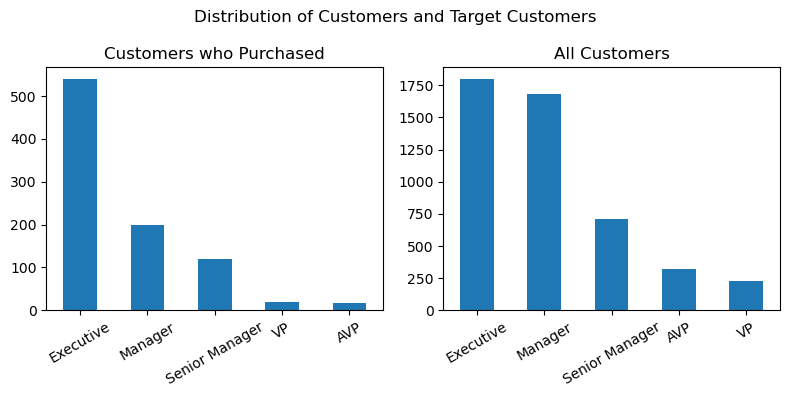

<IPython.core.display.Javascript object>

In [35]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(8, 4))


customers["Designation"].value_counts().plot(kind="bar", ax=ax1)
ax1.set_title("Customers who Purchased")
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=30)

tourism["Designation"].value_counts().plot(kind="bar", ax=ax2)
ax2.set_title("All Customers")
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=30)

fig.suptitle("Distribution of Customers and Target Customers")

fig.tight_layout()
plt.show()

#### What about failed pitches?

<Figure size 800x600 with 0 Axes>

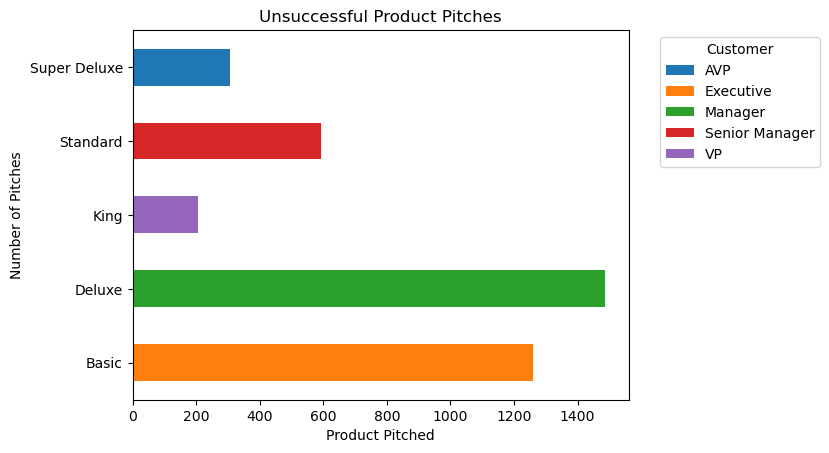

<IPython.core.display.Javascript object>

In [36]:
# create graph of customers who did not purchase
plt.figure(figsize=(8, 6))
failed.groupby(["ProductPitched", "Designation"]).size().unstack().plot(
    kind="barh", stacked=True
)
plt.xlabel("Product Pitched")
plt.ylabel("Number of Pitches")
plt.title("Unsuccessful Product Pitches")
plt.legend(title="Customer", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.show()


In [37]:
# Quick overview of the pitch failures dataset
failed.describe().T

,count,mean,std,min,25%,50%,75%,max
ProdTaken,3853.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
Age,3853.0,38.143265,8.802891,18.0,32.0,36.0,44.0,61.0
CityTier,3853.0,1.616662,0.902979,1.0,1.0,1.0,3.0,3.0
DurationOfPitch,3853.0,15.087205,8.310322,5.0,9.0,13.0,18.0,127.0
NumberOfPersonVisiting,3853.0,2.908124,0.728709,1.0,2.0,3.0,3.0,5.0
NumberOfFollowups,3853.0,3.652479,0.995534,1.0,3.0,4.0,4.0,6.0
PreferredPropertyStar,3853.0,3.543473,0.780734,3.0,3.0,3.0,4.0,5.0
NumberOfTrips,3853.0,3.202440,1.765165,1.0,2.0,3.0,4.0,22.0
Passport,3853.0,0.232287,0.422346,0.0,0.0,0.0,0.0,1.0
PitchSatisfactionScore,3853.0,3.016870,1.376436,1.0,2.0,3.0,4.0,5.0


<IPython.core.display.Javascript object>

In [38]:
# And a quick look at our categories
failed.describe(include="category").T

,count,unique,top,freq
TypeofContact,3853,2,Self Enquiry,2775
Occupation,3853,3,Salaried,1893
Gender,3853,2,Male,2273
ProductPitched,3853,5,Deluxe,1486
MaritalStatus,3853,4,Married,1965
Designation,3853,5,Manager,1486


<IPython.core.display.Javascript object>

__Quick observations__
* We're spending 15 minutes on average for unsuccessful pitches, with about the same number of followups as successful ones
    * We have an outlier here of 127 minutes invested for an unsuccessful pitch. Either the sales rep needs coaching, or that's a typo
* The age for non-buyers skews a little older, at 38 yrs old on average
* We seem to be less successful in Tier 1 cities
* On the whole, these non-buyers have the income to support travel, and they seem to travel about as frequently as our travelers
* Most of our failed pitches originate through self-inquiry

In [39]:
int((len(tourism.loc[tourism["ProdTaken"] == 1]) / len(tourism.index)) * 100)

18

<IPython.core.display.Javascript object>

In [40]:
print(
    "Overall, our data after de-duplication shows that",
    int((len(tourism.loc[tourism["ProdTaken"] == 1]) / len(tourism.index)) * 100),
    "%",
    "of customers purchased some product last year.\n",
)

print(
    "Our Basic Package pitches succeed",
    "{:.0%}".format(
        len(customers_basic) / len(tourism.loc[tourism["ProductPitched"] == "Basic"])
    ),
    "of the time, with an average of",
    int(customers_basic["DurationOfPitch"].mean()),
    "minutes invested. \nAverage customers satisfaction is",
    int(customers_basic["PitchSatisfactionScore"].mean()),
    "on a scale of 1-5.",
    "\n",
)

print(
    "Our Standard Package pitches succeed",
    "{:.0%}".format(
        len(customers_standard)
        / len(tourism.loc[tourism["ProductPitched"] == "Standard"])
    ),
    "of the time, with an average of",
    int(customers_standard["DurationOfPitch"].mean()),
    "minutes invested. \nAverage customers satisfaction is",
    int(customers_standard["PitchSatisfactionScore"].mean()),
    "on a scale of 1-5.",
    "\n",
)

print(
    "Our Deluxe Package pitches succeed",
    "{:.0%}".format(
        len(customers_deluxe) / len(tourism.loc[tourism["ProductPitched"] == "Deluxe"])
    ),
    "of the time, with an average of",
    int(customers_deluxe["DurationOfPitch"].mean()),
    "minutes invested. \nAverage customers satisfaction is",
    int(customers_deluxe["PitchSatisfactionScore"].mean()),
    "on a scale of 1-5.",
    "\n",
)

print(
    "Our Super Deluxe Package pitches succeed",
    "{:.0%}".format(
        len(customers_super)
        / len(tourism.loc[tourism["ProductPitched"] == "Super Deluxe"])
    ),
    "of the time, with an average of",
    int(customers_super["DurationOfPitch"].mean()),
    "minutes invested. \nAverage customers satisfaction is",
    int(customers_super["PitchSatisfactionScore"].mean()),
    "on a scale of 1-5.",
    "\n",
)

print(
    "Our King Package pitches succeed",
    "{:.0%}".format(
        len(customers_king) / len(tourism.loc[tourism["ProductPitched"] == "King"])
    ),
    "of the time, with an average of",
    int(customers_king["DurationOfPitch"].mean()),
    "minutes invested. \nAverage customers satisfaction is",
    int(customers_king["PitchSatisfactionScore"].mean()),
    "on a scale of 1-5.",
)

Overall, our data after de-duplication shows that 18 % of customers purchased some product last year.

Our Basic Package pitches succeed 30% of the time, with an average of 15 minutes invested. 
Average customers satisfaction is 3 on a scale of 1-5. 

Our Standard Package pitches succeed 17% of the time, with an average of 18 minutes invested. 
Average customers satisfaction is 3 on a scale of 1-5. 

Our Deluxe Package pitches succeed 12% of the time, with an average of 18 minutes invested. 
Average customers satisfaction is 3 on a scale of 1-5. 

Our Super Deluxe Package pitches succeed 5% of the time, with an average of 19 minutes invested. 
Average customers satisfaction is 3 on a scale of 1-5. 

Our King Package pitches succeed 9% of the time, with an average of 10 minutes invested. 
Average customers satisfaction is 3 on a scale of 1-5.


<IPython.core.display.Javascript object>

#### Observations

* __Surprisingly, we seem to pitch only specific packages to specific customer types.__
    * For example, we only pitch the Standard package to Senior Managers, and Senior Managers only purchase the Standard Package
    * Presumably, we've designed these packages for specific types of target customers, and that's all we offer them
    * We could certainly sell a more diverse set of offerings to each type of customer by modifying our sales process
* __The Basic package - offered to Executives - is the most popular, with the bulk of sales__
    * Deluxe, Standard, King, and Super Deluxe follow in order of popularity
<br><br>
* __Characteristics of the products and buyers of our successful pitches:__
    * __Basic Package:__
        * Most often purchased by salaried employees making about \\$20K/mo in top-tier cities, on average about 31 years old and about 60\% are male.
        * About half are married or partnered, and they average about 3 trips per year. 80\% are traveling with children
        * We exclusively pitched to Executives, and we spent about 15 minutes in the sales process, with about 4 followups. 
    * __Deluxe Package:__
        * About half the buyers are small-business managers earning about \\$23K/mo, but some significantly higher income. They are usually a little older, on average about 38. A little larger percentage are male - 67\%
        * These folks are less likely to be married (only about 34\%) and about 70\% are living in smaller cities. They are more likely traveling with just a partner or one child, and the majority are looking for value properties (3 star).
        * We pitch this exclusively to Managers, and the sales process takes about 18 minutes, with 4 followups. They are more likely to have a neutral sentiment about the sales experience.
    * __Standard Package:__
        * Similar mix of small-business and salaried to the Deluxe buyers, and they're earning about \\$26K/mo with a much larger variance - both lower, and higher - of their income. Average age is 42, but many Senior Managers are older.
        * These customers live in Tier 1 or Tier 3 cities, and do their own research to initiate queries themselves to our firm. They travel less frequently (3/yr), and only 40\% have a passport.
        * We spend on-average almost 19 minutes working through the sales process with Senior Managers, with 4 followups. Nearly half would be NPS positive about the sales experience.
    * __Super Deluxe Package:__
        * These are generally purchesed by about 44 year old, mostly males, mostly single living in Tier 3 cities but never traveling alone. They all have their own car. They are generally salaried, employees of large companies. They are earning almost \\$20K/mo. 
        * Most were invited by the company, and this was offered exclusively to Associate Vice Presidents.. They take 4 trips/yr on average, and up to as many as 8. Most of them are traveling with children. Only 62\% have passports.
        * For this group, we again spent a little over 19 minutes in the sales process. Buyers required fewer followups; on average, about 3. Most had neutral sentiment about the sales process, but 40\% were strong promoters
    * __King Package:__
        * Buyers of this page are a little older - 49 on average - and more than half are female. They are earning about \\$35K/mo, and living more frequently in Tier 1 cities. These folks are all self-referred; they do their own research and seek out the travel they're interested in. They are mostly small business VPs.
        * They are not traveling alone, and most often traveling with children. About 50\% prefer 4 or 5-star properties; they don't book less than 3-star destinations.
        * We pitch this package exclusively to VPs, and spend about 8-9 minutes in the sales process, with a few significant outliers requiring 18+ minutes. In general, 3-4 followups are required, except in the case of the outliers mentioned.
<br><br>     
* __Based on the success rate of the Super Deluxe package, we're investing more time in the sales cycle for a relatively poor return.  We should consider consolidating that package into another, or re-structuring it.__

## Model Construction

#### Data Preparation

The bulk of our data preparation is already completed - duplicates, missing values, outliers evaluated. We know we have some potential outliers we've considered, and the remaining work is to encode our categories. 

In [41]:
# Here's where we're starting
tourism.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4747 entries, 0 to 4887
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   ProdTaken                 4747 non-null   int64   
 1   Age                       4747 non-null   float64 
 2   TypeofContact             4747 non-null   category
 3   CityTier                  4747 non-null   int64   
 4   DurationOfPitch           4747 non-null   float64 
 5   Occupation                4747 non-null   category
 6   Gender                    4747 non-null   category
 7   NumberOfPersonVisiting    4747 non-null   int64   
 8   NumberOfFollowups         4747 non-null   float64 
 9   ProductPitched            4747 non-null   category
 10  PreferredPropertyStar     4747 non-null   float64 
 11  MaritalStatus             4747 non-null   category
 12  NumberOfTrips             4747 non-null   float64 
 13  Passport                  4747 non-null   int64 

<IPython.core.display.Javascript object>

In [42]:
# OneHotEncoding our categories
oneHotCols = [
    "TypeofContact",
    "Occupation",
    "Gender",
    "ProductPitched",
    "MaritalStatus",
    "Designation",
]
tourism = pd.get_dummies(tourism, columns=oneHotCols)

<IPython.core.display.Javascript object>

In [43]:
# Here's what we'll work with to build our models
tourism.head().T

,0,1,2,3,4
ProdTaken,1.0,0.0,1.0,0.0,0.0
Age,41.0,49.0,37.0,33.0,36.0
CityTier,3.0,1.0,1.0,1.0,1.0
DurationOfPitch,6.0,14.0,8.0,9.0,8.0
NumberOfPersonVisiting,3.0,3.0,3.0,2.0,2.0
NumberOfFollowups,3.0,4.0,4.0,3.0,3.0
PreferredPropertyStar,3.0,4.0,3.0,3.0,4.0
NumberOfTrips,1.0,2.0,7.0,2.0,1.0
Passport,1.0,0.0,1.0,1.0,0.0
PitchSatisfactionScore,2.0,3.0,3.0,5.0,5.0


<IPython.core.display.Javascript object>

## Prediction Models

For the introduction of our new Wellness Tourism Package, we don't have any labeled data to support predictions for our new package - but we do know something about the characteristics of customers that have, or have not, purchased our other travel package offerings.

The rubric calls for profiling the products, but I believe it should focus on profiling the customers.

In any case, we're trying to use the past behavior of purchasing a travel package as an indication that a customer might be likely to purchase a new offering. We're not considering here any market research that would make the features of this package attractive to potential new buyers, just analyzing our existing customer data.

The dependent variable in our data is __ProdTaken__.

__What are the consequences of predicting the wrong result?__
  * If we predict that a customer will not purchase our new package, but they actually would purchase then we missed the opportunity to engage with them, and we potentially __lose the business__ by not offering it.
  * If we predict that a customer is a good candidate to purchase the new package, but they turn out not to want one - we __lose some time__ in the sales process, but it's negligible. 
  
__What's the greater negative consequence?__
  * Failing to correctly identify all of the potential customers for our new travel package - we can lose valuable business
  
__We should optimize our model for recall__
  * This gives us the ratio of Predicted positives to Actual positives, so we'll minimize our false negatives

#### Useful Common Functions to Evaluate Performance

In [44]:
## Function to create confusion matrix
def make_confusion_matrix(model, y_actual, labels=[1, 0]):
    """
    model : classifier to predict values of X
    y_actual : ground truth

    """
    y_predict = model.predict(X_test)
    cm = metrics.confusion_matrix(y_actual, y_predict, labels=[0, 1])
    df_cm = pd.DataFrame(
        cm,
        index=[i for i in ["Actual - No", "Actual - Yes"]],
        columns=[i for i in ["Predicted - No", "Predicted - Yes"]],
    )
    group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cm.flatten() / np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts, group_percentages)]
    labels = np.asarray(labels).reshape(2, 2)
    plt.figure(figsize=(10, 7))
    sns.heatmap(df_cm, annot=labels, fmt="")
    plt.ylabel("True label")
    plt.xlabel("Predicted label")

<IPython.core.display.Javascript object>

In [45]:
##  Function to calculate different metric scores of the model - Accuracy, Recall and Precision
def get_metrics_score(model, flag=True):
    """
    model : classifier to predict values of X

    """
    # defining an empty list to store train and test results
    score_list = []

    # Predicting on train and tests
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)

    # Accuracy of the model
    train_acc = model.score(X_train, y_train)
    test_acc = model.score(X_test, y_test)

    # Recall of the model
    train_recall = metrics.recall_score(y_train, pred_train)
    test_recall = metrics.recall_score(y_test, pred_test)

    # Precision of the model
    train_precision = metrics.precision_score(y_train, pred_train)
    test_precision = metrics.precision_score(y_test, pred_test)

    # F1 Score of the model
    train_f1 = metrics.f1_score(y_train, pred_train)
    test_f1 = metrics.f1_score(y_test, pred_test)

    score_list.extend(
        (
            train_acc,
            test_acc,
            train_recall,
            test_recall,
            train_precision,
            test_precision,
            train_f1,
            test_f1,
        )
    )

    # If the flag is set to True then only the following print statements will be dispayed. The default value is set to True.
    if flag == True:
        print("Accuracy on training set : ", model.score(X_train, y_train))
        print("Accuracy on test set : ", model.score(X_test, y_test))
        print("Recall on training set : ", metrics.recall_score(y_train, pred_train))
        print("Recall on test set : ", metrics.recall_score(y_test, pred_test))
        print(
            "Precision on training set : ", metrics.precision_score(y_train, pred_train)
        )
        print("Precision on test set : ", metrics.precision_score(y_test, pred_test))
        print("F1 on training set : ", metrics.f1_score(y_train, pred_train))
        print("F1 on test set : ", metrics.f1_score(y_test, pred_test))

    return score_list  # returning the list with train and test scores

<IPython.core.display.Javascript object>

#### Split the data into Test and Train sets

In [46]:
X = tourism.drop("ProdTaken", axis=1)
y = tourism.pop("ProdTaken")

<IPython.core.display.Javascript object>

In [47]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.30, random_state=1, stratify=y
)

<IPython.core.display.Javascript object>

In [48]:
# Confirm we got good stratification in our test and train datasets
print("Shape of Training set : ", X_train.shape)
print("Shape of test set : ", X_test.shape)
print("\nPercentage of classes in training set:")
print(y_train.value_counts(normalize=True))
print("\nPercentage of classes in test set:")
print(y_test.value_counts(normalize=True))

Shape of Training set :  (3322, 35)
Shape of test set :  (1425, 35)

Percentage of classes in training set:
0    0.811559
1    0.188441
Name: ProdTaken, dtype: float64

Percentage of classes in test set:
0    0.81193
1    0.18807
Name: ProdTaken, dtype: float64


<IPython.core.display.Javascript object>

### Bagging Data Models

"Bagging" stands for "bootstrap" and "aggregation" and is an ensemble methodology that combines the outcomes of several weaker models to produce a strong predictor.  We'll explore several bagging techniques in this section.

#### Bagging Classifier

We'll start with a Bagging classifier with default parameters
__We'll use the default Decision Tree base estimator__

In [49]:
# base_estimator for bagging classifier is a decision tree by default
bagging_estimator = BaggingClassifier(random_state=1)
bagging_estimator.fit(X_train, y_train)

BaggingClassifier(random_state=1)

<IPython.core.display.Javascript object>

In [50]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
bagging_estimator_score = get_metrics_score(bagging_estimator)

Accuracy on training set :  0.9930764599638772
Accuracy on test set :  0.9017543859649123
Recall on training set :  0.963258785942492
Recall on test set :  0.6156716417910447
Precision on training set :  1.0
Precision on test set :  0.8168316831683168
F1 on training set :  0.9812855980471928
F1 on test set :  0.702127659574468


<IPython.core.display.Javascript object>

In [51]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    bagging_estimator_score[2] - bagging_estimator_score[3],
)

Recall score spread between Train and Test data is 0.3475871441514473


<IPython.core.display.Javascript object>

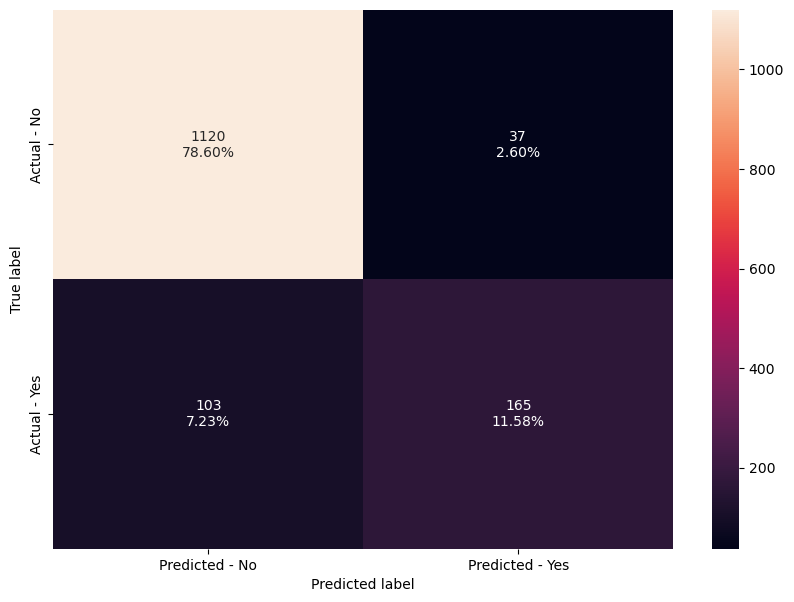

<IPython.core.display.Javascript object>

In [52]:
# Graph the Confusion Matrix
make_confusion_matrix(bagging_estimator, y_test)

* This model is overfitting on training, as we can see from the spread between recall values for training and test data

__Next we'll try a Bagging classifier, passing the base_estimator to specify Logistic Regression__

In [53]:
bagging_lr = BaggingClassifier(
    base_estimator=LogisticRegression(
        solver="liblinear", random_state=1, max_iter=1000
    ),
    random_state=1,
)
bagging_lr.fit(X_train, y_train)

BaggingClassifier(base_estimator=LogisticRegression(max_iter=1000,
                                                    random_state=1,
                                                    solver='liblinear'),
                  random_state=1)

<IPython.core.display.Javascript object>

In [54]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
bagging_lr_score = get_metrics_score(bagging_lr)

Accuracy on training set :  0.8296207104154124
Accuracy on test set :  0.8259649122807018
Recall on training set :  0.10702875399361023
Recall on test set :  0.09701492537313433
Precision on training set :  0.9054054054054054
Precision on test set :  0.8125
F1 on training set :  0.19142857142857145
F1 on test set :  0.17333333333333334


<IPython.core.display.Javascript object>

In [55]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    bagging_lr_score[2] - bagging_lr_score[3],
)

Recall score spread between Train and Test data is 0.010013828620475895


<IPython.core.display.Javascript object>

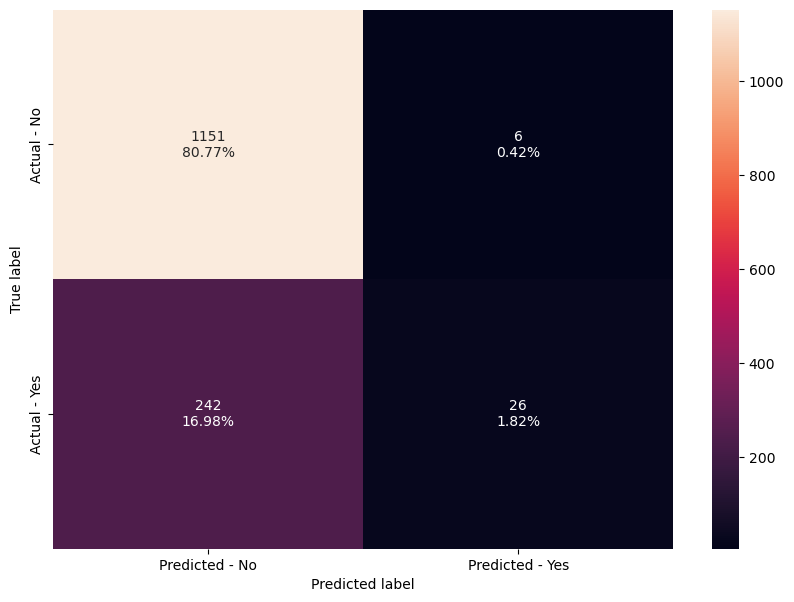

<IPython.core.display.Javascript object>

In [56]:
# Graph the Confusion Matrix
make_confusion_matrix(bagging_lr, y_test)

* Well, it stopped overfitting. But the recall is completely unuseable. Logistic regression as a base estimator is probably not a good fit for this problem.

##### Tuned Bagging Classifier

Next we'll try tuning the Bagging classifier, running GridSearch.  The critical parameters here are:

* base_estimator: The base estimator to fit on random subsets of the dataset. If None(default), then the base estimator is a decision tree.
* n_estimators: The number of trees in the forest, default = 100.
* max_features: The number of features to consider when looking for the best split.
* bootstrap: Whether bootstrap samples are used when building trees. If False, the entire dataset is used to build each tree, default=True.
* bootstrap_features: If it is true, then features are drawn with replacement. Default value is False.
* max_samples: If bootstrap is True, then the number of samples to draw from X to train each base estimator. If None (default), then draw N samples, where N is the number of observations in the train data.
* oob_score: Whether to use out-of-bag samples to estimate the generalization accuracy, default=False.

In [57]:
%%time
# Choose the type of classifier. 
bagging_estimator_tuned = BaggingClassifier(random_state=1,oob_score=True)

# Grid of parameters to choose from
## add from article
parameters = {'max_samples': [0.7,0.8,0.9,1], 
              'max_features': [0.6,0.7,0.8,0.9],
              'n_estimators' : [10,20,30,40,50],
             }

# Type of scoring used to compare parameter combinations - optimizing for recall
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(bagging_estimator_tuned, parameters, scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
bagging_estimator_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
bagging_estimator_tuned.fit(X_train, y_train)

Wall time: 7.67 s


BaggingClassifier(max_features=0.9, max_samples=0.9, n_estimators=50,
                  oob_score=True, random_state=1)

<IPython.core.display.Javascript object>

In [58]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
bagging_estimator_tuned_score = get_metrics_score(bagging_estimator_tuned)

Accuracy on training set :  1.0
Accuracy on test set :  0.9235087719298246
Recall on training set :  1.0
Recall on test set :  0.6716417910447762
Precision on training set :  1.0
Precision on test set :  0.8955223880597015
F1 on training set :  1.0
F1 on test set :  0.7675906183368871


<IPython.core.display.Javascript object>

In [59]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    bagging_estimator_tuned_score[2] - bagging_estimator_tuned_score[3],
)

Recall score spread between Train and Test data is 0.32835820895522383


<IPython.core.display.Javascript object>

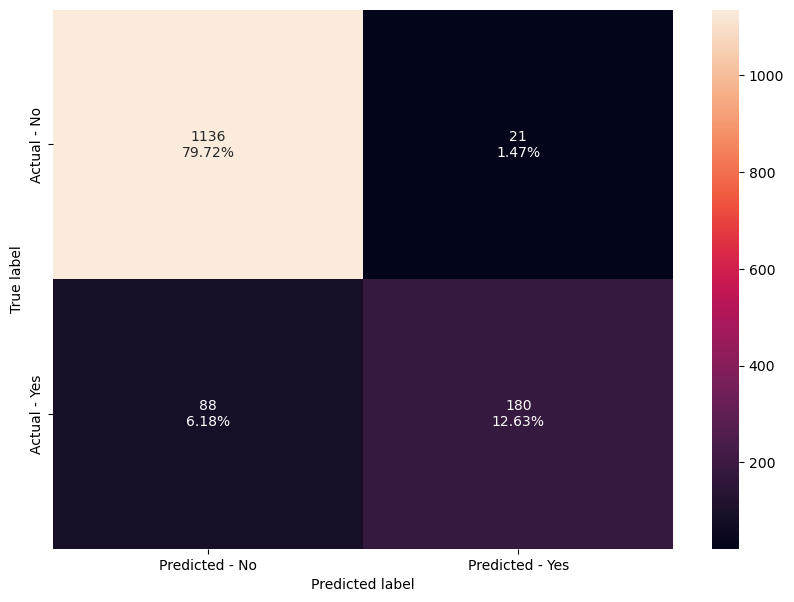

<IPython.core.display.Javascript object>

In [60]:
# Graph the Confusion Matrix
make_confusion_matrix(bagging_estimator_tuned, y_test)

Better, but still overfitting. Enabling oob_scoring actually didn't help.

#### Random Forest

Next we'll try a Random Forest classifier with default parameters

In [61]:
# Train the random forest classifier
rf_estimator = RandomForestClassifier(random_state=1)
rf_estimator.fit(X_train, y_train)

RandomForestClassifier(random_state=1)

<IPython.core.display.Javascript object>

In [62]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
rf_estimator_score = get_metrics_score(rf_estimator)

Accuracy on training set :  1.0
Accuracy on test set :  0.9087719298245615
Recall on training set :  1.0
Recall on test set :  0.5559701492537313
Precision on training set :  1.0
Precision on test set :  0.93125
F1 on training set :  1.0
F1 on test set :  0.6962616822429906


<IPython.core.display.Javascript object>

In [63]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    rf_estimator_score[2] - rf_estimator_score[3],
)

Recall score spread between Train and Test data is 0.44402985074626866


<IPython.core.display.Javascript object>

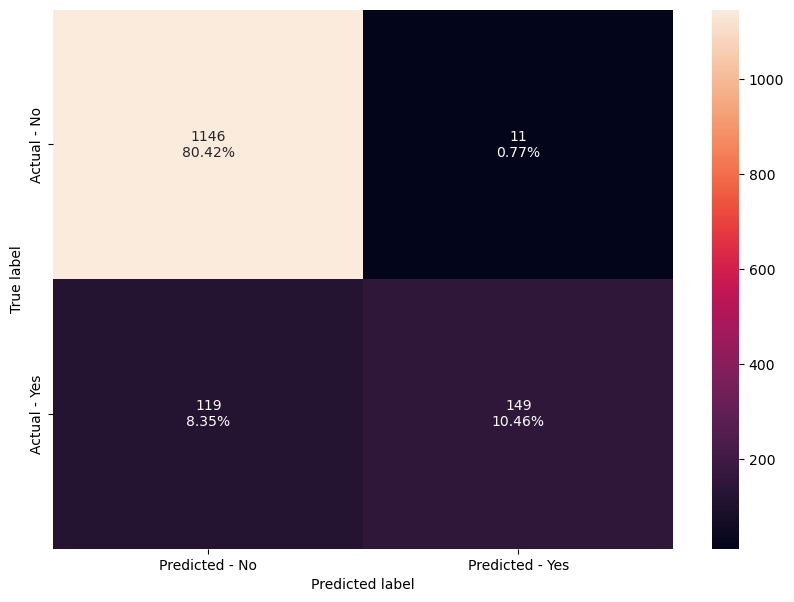

<IPython.core.display.Javascript object>

In [64]:
# Graph the Confusion Matrix
make_confusion_matrix(rf_estimator, y_test)

Accuracy is good, but recall is terrible and this model overfits as well

##### Tuned Random Forest

Next up is Random Forest with hyperparameter tuning.  The critical parameters here are:

* n_estimators: The number of trees in the forest, default = 100.
* max_features: The number of features to consider when looking for the best split.
* class_weight: Weights associated with classes in the form {class_label: weight}.If not given, all classes are supposed to have weight one.
    * For example: If the frequency of class 0 is 80% and the frequency of class 1 is 20% in the data, then class 0 will become the dominant class and the model will become biased toward the dominant classes. In this case, we can pass a dictionary {0:0.2,1:0.8} to the model to specify the weight of each class and the random forest will give more weightage to class 1.
* bootstrap: Whether bootstrap samples are used when building trees. If False, the entire dataset is used to build each tree, default=True.
* max_samples: If bootstrap is True, then the number of samples to draw from X to train each base estimator. If None (default), then draw N samples, where N is the number of observations in the train data.
* oob_score: Whether to use out-of-bag samples to estimate the generalization accuracy, default=False.

Note: Many hyperparameters of Decision Trees are also available to tune Random Forest like max_depth, min_sample_split etc.

In [65]:
%%time
# Choose the type of classifier. 
rf_estimator_tuned = RandomForestClassifier(random_state=1,class_weight="balanced",max_depth=4)

# Grid of parameters to choose from
## add from article
parameters = {"n_estimators": [150,200,250,400],
    "criterion":["gini","entropy"],
    "min_samples_split" : np.arange(10,15),
    "min_samples_leaf": np.arange(5, 15),
    "max_features": ["sqrt", "log2"],
    "max_samples": np.arange(0.3, 0.7, 0.9),
             }

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(rf_estimator_tuned, parameters, scoring=acc_scorer,cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
rf_estimator_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
rf_estimator_tuned.fit(X_train, y_train)

Wall time: 1min 12s


RandomForestClassifier(class_weight='balanced', max_depth=4,
                       max_features='sqrt', max_samples=0.3,
                       min_samples_leaf=12, min_samples_split=10,
                       n_estimators=150, random_state=1)

<IPython.core.display.Javascript object>

In [66]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
rf_estimator_tuned_score = get_metrics_score(rf_estimator_tuned)

Accuracy on training set :  0.7534617700180614
Accuracy on test set :  0.7536842105263157
Recall on training set :  0.6549520766773163
Recall on test set :  0.6194029850746269
Precision on training set :  0.40473840078973344
Precision on test set :  0.4
F1 on training set :  0.5003050640634533
F1 on test set :  0.486090775988287


<IPython.core.display.Javascript object>

In [67]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    rf_estimator_tuned_score[2] - rf_estimator_tuned_score[3],
)

Recall score spread between Train and Test data is 0.035549091602689376


<IPython.core.display.Javascript object>

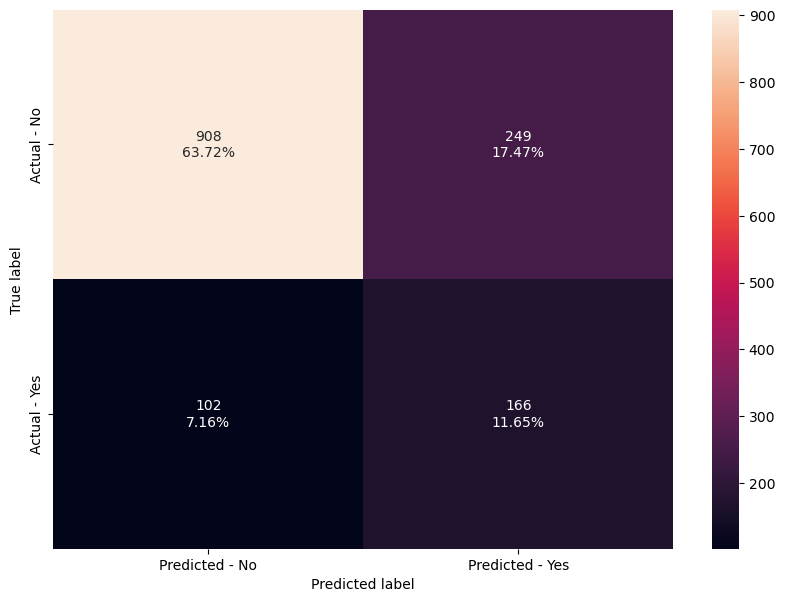

<IPython.core.display.Javascript object>

In [68]:
# Graph the Confusion Matrix
make_confusion_matrix(rf_estimator_tuned, y_test)

* That has definitely reduced overfitting, but accuracy is not terrific
* Note we did use class-weight="balanced" for this model

#### Decision Tree

Next we'll try a full Decision Tree model, and visualize it

In [69]:
# Train our full decision tree
dTree = DecisionTreeClassifier(
    criterion="gini", class_weight="balanced", random_state=1
)
dTree.fit(X_train, y_train)

DecisionTreeClassifier(class_weight='balanced', random_state=1)

<IPython.core.display.Javascript object>

In [70]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
dTree_score = get_metrics_score(dTree)

Accuracy on training set :  1.0
Accuracy on test set :  0.8905263157894737
Recall on training set :  1.0
Recall on test set :  0.6940298507462687
Precision on training set :  1.0
Precision on test set :  0.7153846153846154
F1 on training set :  1.0
F1 on test set :  0.7045454545454546


<IPython.core.display.Javascript object>

In [71]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    dTree_score[2] - dTree_score[3],
)

Recall score spread between Train and Test data is 0.30597014925373134


<IPython.core.display.Javascript object>

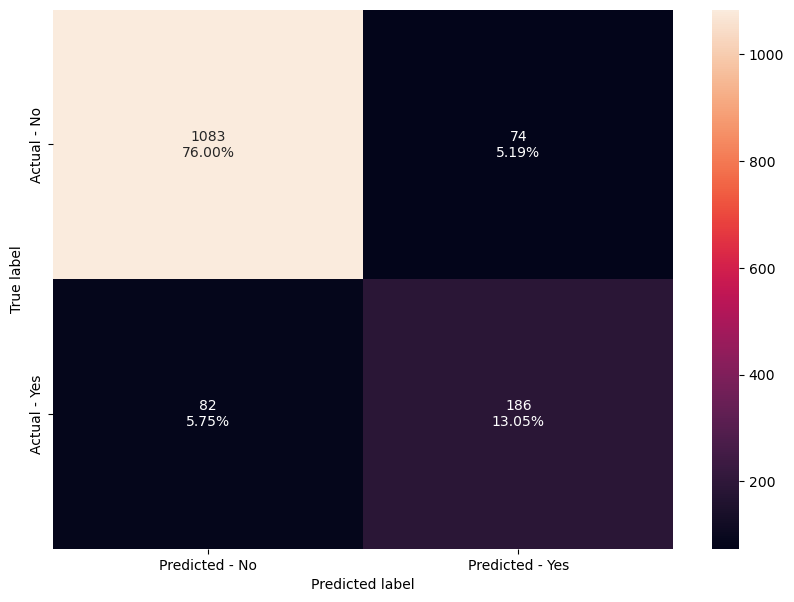

<IPython.core.display.Javascript object>

In [72]:
# Graph the Confusion Matrix
make_confusion_matrix(dTree, y_test)

In [73]:
# Get our list of independent features. We need these to visualize decision trees
feature_names = list(X.columns)
print(feature_names)

['Age', 'CityTier', 'DurationOfPitch', 'NumberOfPersonVisiting', 'NumberOfFollowups', 'PreferredPropertyStar', 'NumberOfTrips', 'Passport', 'PitchSatisfactionScore', 'OwnCar', 'NumberOfChildrenVisiting', 'MonthlyIncome', 'TypeofContact_Company Invited', 'TypeofContact_Self Enquiry', 'Occupation_Free Lancer', 'Occupation_Large Business', 'Occupation_Salaried', 'Occupation_Small Business', 'Gender_Fe Male', 'Gender_Female', 'Gender_Male', 'ProductPitched_Basic', 'ProductPitched_Deluxe', 'ProductPitched_King', 'ProductPitched_Standard', 'ProductPitched_Super Deluxe', 'MaritalStatus_Divorced', 'MaritalStatus_Married', 'MaritalStatus_Single', 'MaritalStatus_Unmarried', 'Designation_AVP', 'Designation_Executive', 'Designation_Manager', 'Designation_Senior Manager', 'Designation_VP']


<IPython.core.display.Javascript object>

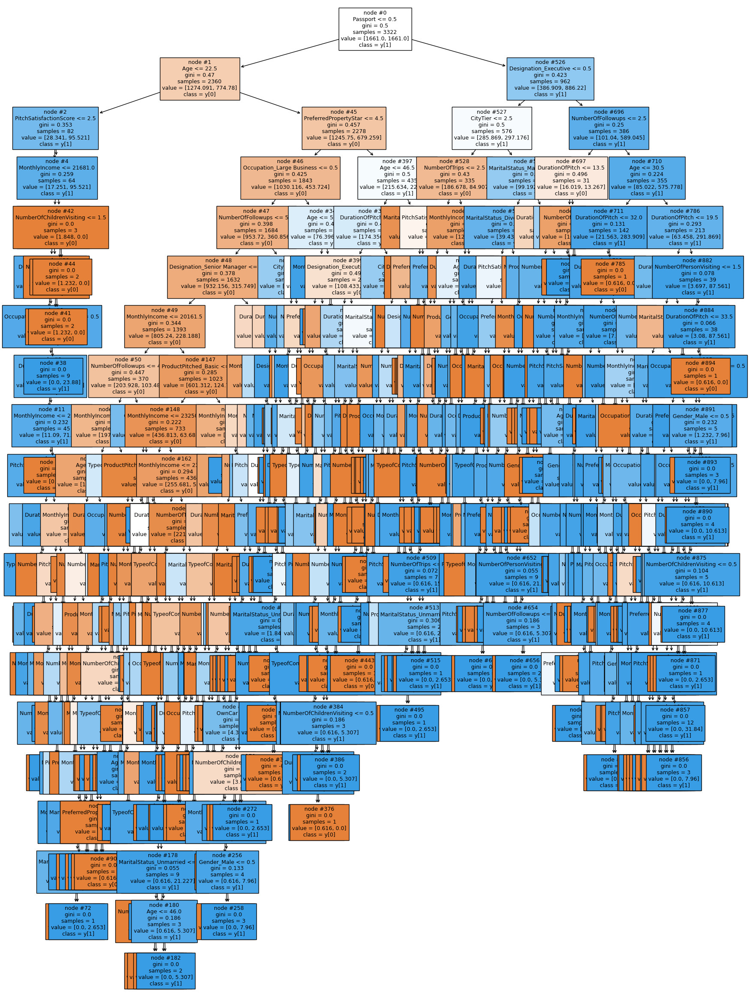

<IPython.core.display.Javascript object>

In [74]:
# Visualize the full decision tree
plt.figure(figsize=(20, 30))
tree.plot_tree(
    dTree,
    feature_names=feature_names,
    filled=True,
    fontsize=9,
    node_ids=True,
    class_names=True,
)
plt.show()

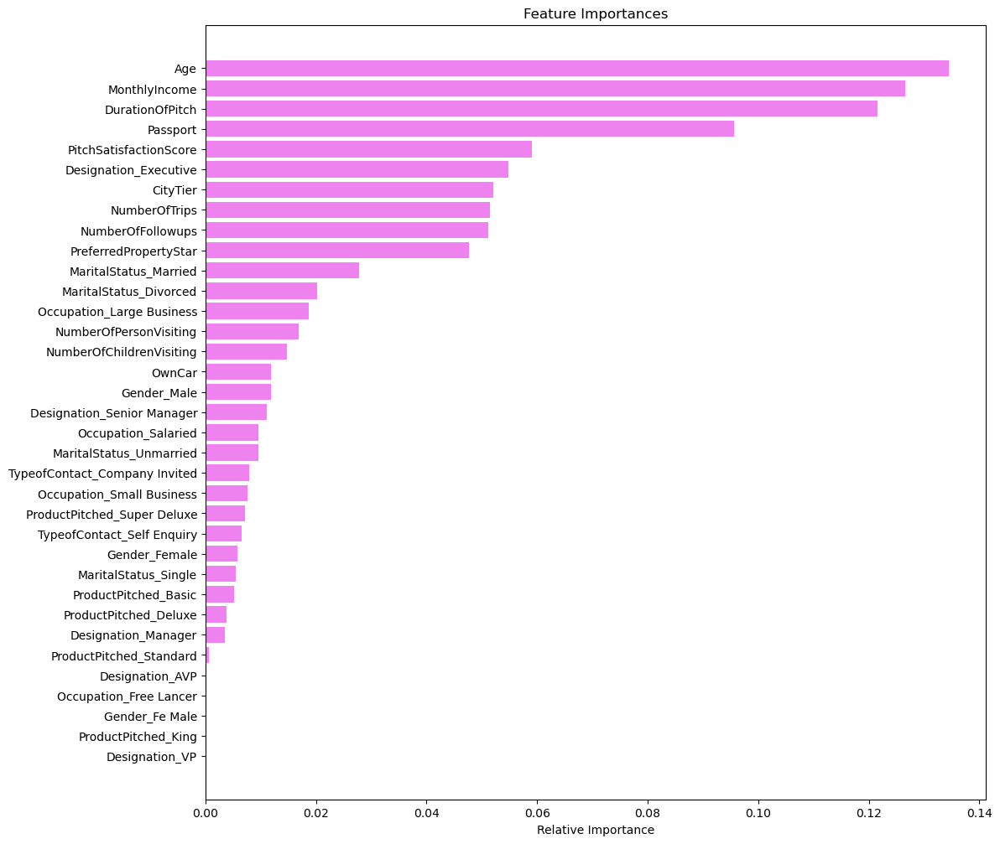

<IPython.core.display.Javascript object>

In [75]:
# Visualize the Gini importances of our features
importances = dTree.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

* This is a classically over-trained and complex model.
* Note we used class weighting for this model, as well

##### Tuned Decision Tree

Next we'll run a grid search to try to tune our Decision Tree model

In [76]:
%%time
# Choose the type of classifier.
dTree_tuned = DecisionTreeClassifier(random_state=1,class_weight="balanced")

# Grid of parameters to choose from
parameters = {
    "max_depth": np.arange(4, 10),
    "min_samples_split" : np.arange(15,20),
    "min_samples_leaf": [10,15, 20, 30],
    "max_features": np.arange(0.2, 0.9),
    "min_impurity_decrease": [0.001,0.01, 0.1],
}

# Type of scoring used to compare parameter combinations
scoring = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(dTree_tuned, parameters, scoring=scoring, cv=10, return_train_score=True)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
dTree_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
dTree_tuned.fit(X_train, y_train)

Wall time: 21.9 s


DecisionTreeClassifier(class_weight='balanced', max_depth=6, max_features=0.2,
                       min_impurity_decrease=0.001, min_samples_leaf=20,
                       min_samples_split=15, random_state=1)

<IPython.core.display.Javascript object>

In [77]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
dTree_tuned_score = get_metrics_score(dTree_tuned)

Accuracy on training set :  0.6947621914509332
Accuracy on test set :  0.6652631578947369
Recall on training set :  0.792332268370607
Recall on test set :  0.746268656716418
Precision on training set :  0.35942028985507246
Precision on test set :  0.3284072249589491
F1 on training set :  0.49451645064805577
F1 on test set :  0.45610034207525657


<IPython.core.display.Javascript object>

In [78]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    dTree_tuned_score[2] - dTree_tuned_score[3],
)

Recall score spread between Train and Test data is 0.04606361165418904


<IPython.core.display.Javascript object>

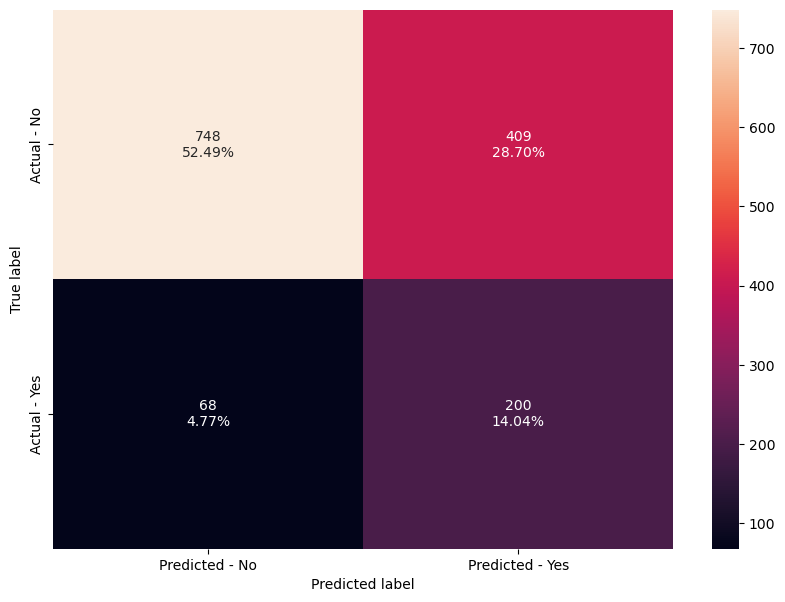

<IPython.core.display.Javascript object>

In [79]:
# Graph the Confusion Matrix
make_confusion_matrix(dTree_tuned, y_test)

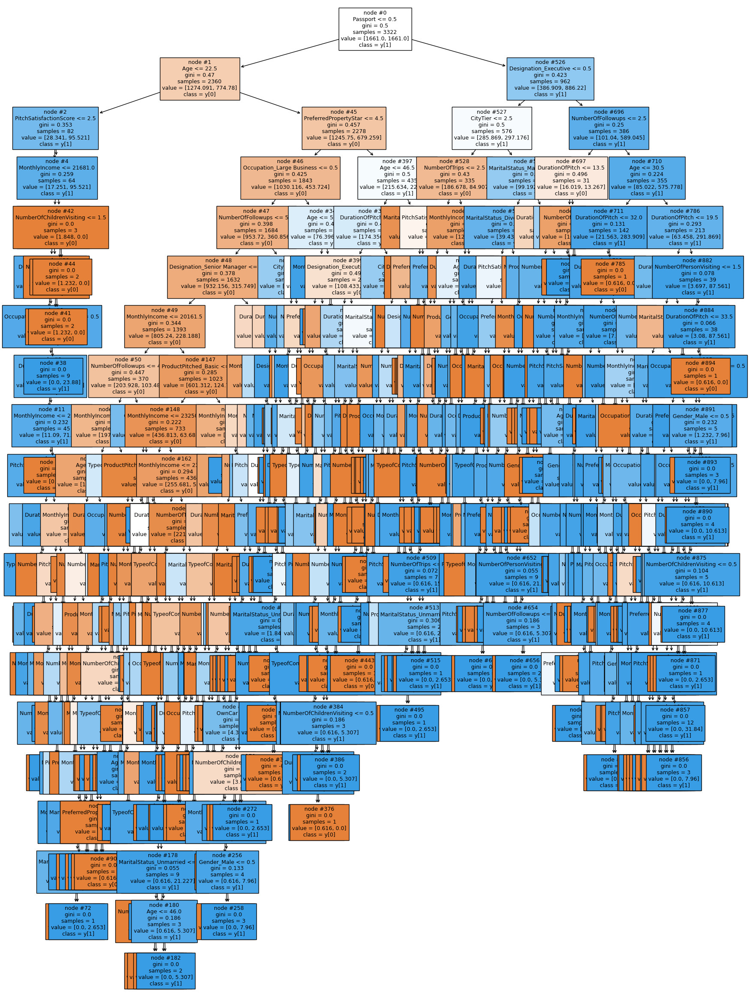

<IPython.core.display.Javascript object>

In [80]:
# Visualize the full decision tree
plt.figure(figsize=(20, 30))
tree.plot_tree(
    dTree,
    feature_names=feature_names,
    filled=True,
    fontsize=9,
    node_ids=True,
    class_names=True,
)
plt.show()

* The recall scores are pretty good, and the model's not overfitting.  But accuracy is relatively poor.

##### Tuned Decision Tree (Cost Complexity Pruned)

One more optimization we'll try for Descision tree is to post-prune using minimal cost complexity pruning

In [81]:
# we'll build our decision tree classifier, and then iterate to use an ccp_alpha value based on our validation
dTree_ccp = DecisionTreeClassifier(random_state=1)
path = dTree_ccp.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

<IPython.core.display.Javascript object>

In [82]:
# Train a decision tree with the effective alphas
clfs = []
for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(random_state=1, ccp_alpha=ccp_alpha)
    clf.fit(X_train, y_train)
    clfs.append(clf)
print(
    "Number of nodes in the last tree is: {} with ccp_alpha: {}".format(
        clfs[-1].tree_.node_count, ccp_alphas[-1]
    )
)

Number of nodes in the last tree is: 1 with ccp_alpha: 0.02054636624893441


<IPython.core.display.Javascript object>

In [83]:
# Remove the last element with only the one node
clfs = clfs[:-1]
ccp_alphas = ccp_alphas[:-1]

<IPython.core.display.Javascript object>

In [84]:
# Let's plot the train and test scores for accuracy
train_scores = [clf.score(X_train, y_train) for clf in clfs]
test_scores = [clf.score(X_test, y_test) for clf in clfs]

<IPython.core.display.Javascript object>

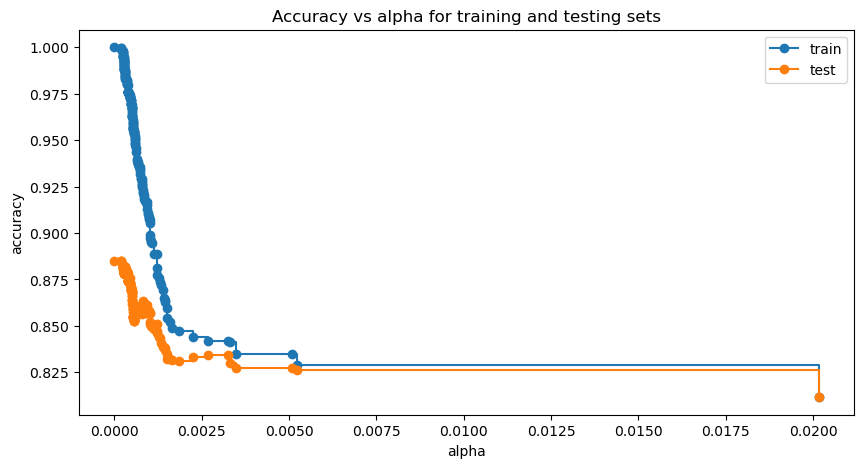

<IPython.core.display.Javascript object>

In [85]:
# Draw the plot for accuracy versus alpha
fig, ax = plt.subplots(figsize=(10, 5))
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for training and testing sets")
ax.plot(ccp_alphas, train_scores, marker="o", label="train", drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker="o", label="test", drawstyle="steps-post")
ax.legend()
plt.show()

In [86]:
index_best_model = np.argmax(test_scores)
best_model = clfs[index_best_model]
print(best_model)
print("Training accuracy of best model: ", best_model.score(X_train, y_train))
print("Test accuracy of best model: ", best_model.score(X_test, y_test))

DecisionTreeClassifier(random_state=1)
Training accuracy of best model:  1.0
Test accuracy of best model:  0.8849122807017544


<IPython.core.display.Javascript object>

* __Which is wonderful, but we want to optimize for recall__

In [87]:
# Plot our recall scores for test and train data
recall_train = []
for clf in clfs:
    pred_train3 = clf.predict(X_train)
    values_train = metrics.recall_score(y_train, pred_train3)
    recall_train.append(values_train)

<IPython.core.display.Javascript object>

In [88]:
# Plot our recall scores for test and train data
recall_test = []
for clf in clfs:
    pred_test3 = clf.predict(X_test)
    values_test = metrics.recall_score(y_test, pred_test3)
    recall_test.append(values_test)

<IPython.core.display.Javascript object>

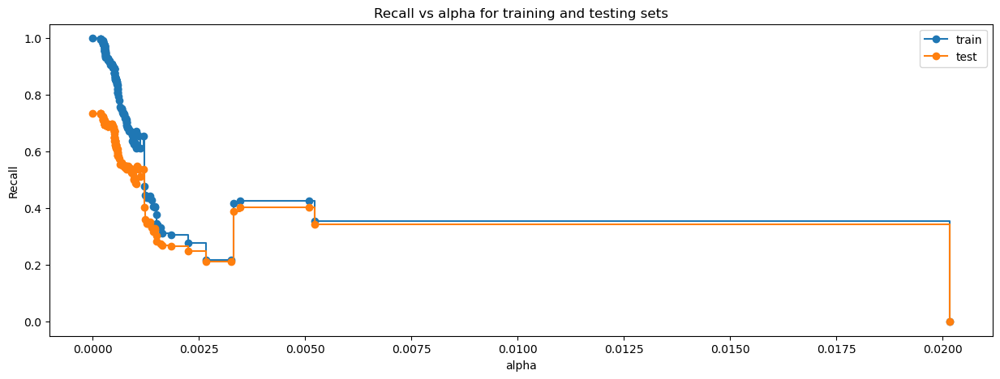

<IPython.core.display.Javascript object>

In [89]:
# Draw recall versus alpha for test and training datasets
fig, ax = plt.subplots(figsize=(15, 5))
ax.set_xlabel("alpha")
ax.set_ylabel("Recall")
ax.set_title("Recall vs alpha for training and testing sets")
ax.plot(ccp_alphas, recall_train, marker="o", label="train", drawstyle="steps-post")
ax.plot(ccp_alphas, recall_test, marker="o", label="test", drawstyle="steps-post")
ax.legend()
plt.show()

In [90]:
# creating the model where we get highest train and test recall
index_best_model = np.argmax(recall_test)
dTree_ccp = clfs[index_best_model]
print(dTree_ccp)

DecisionTreeClassifier(random_state=1)


<IPython.core.display.Javascript object>

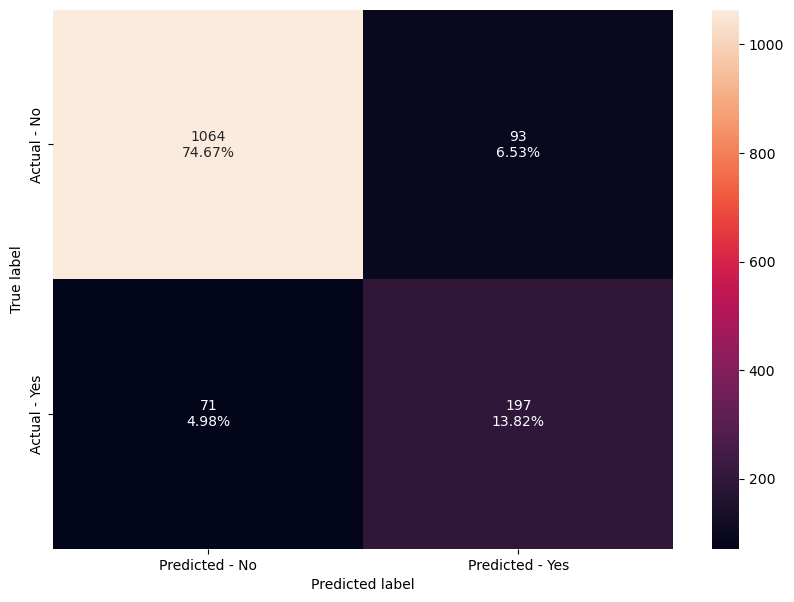

<IPython.core.display.Javascript object>

In [91]:
# Graph the Confusion Matrix
make_confusion_matrix(dTree_ccp, y_test)

In [92]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
dTree_ccp_score = get_metrics_score(dTree_ccp)

Accuracy on training set :  1.0
Accuracy on test set :  0.8849122807017544
Recall on training set :  1.0
Recall on test set :  0.7350746268656716
Precision on training set :  1.0
Precision on test set :  0.6793103448275862
F1 on training set :  1.0
F1 on test set :  0.7060931899641576


<IPython.core.display.Javascript object>

In [93]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    dTree_ccp_score[2] - dTree_ccp_score[3],
)

Recall score spread between Train and Test data is 0.2649253731343284


<IPython.core.display.Javascript object>

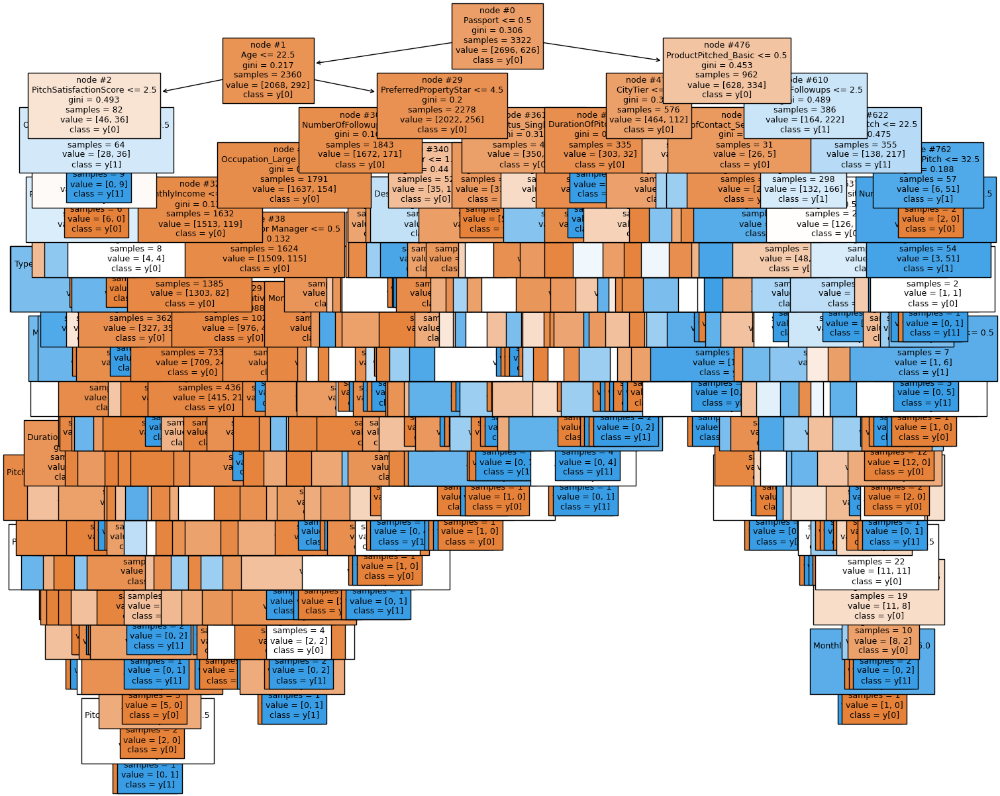

<IPython.core.display.Javascript object>

In [94]:
# Visualize the full decision tree
plt.figure(figsize=(17, 15))

tree.plot_tree(
    dTree_ccp,
    feature_names=feature_names,
    filled=True,
    fontsize=9,
    node_ids=True,
    class_names=True,
)
plt.show()

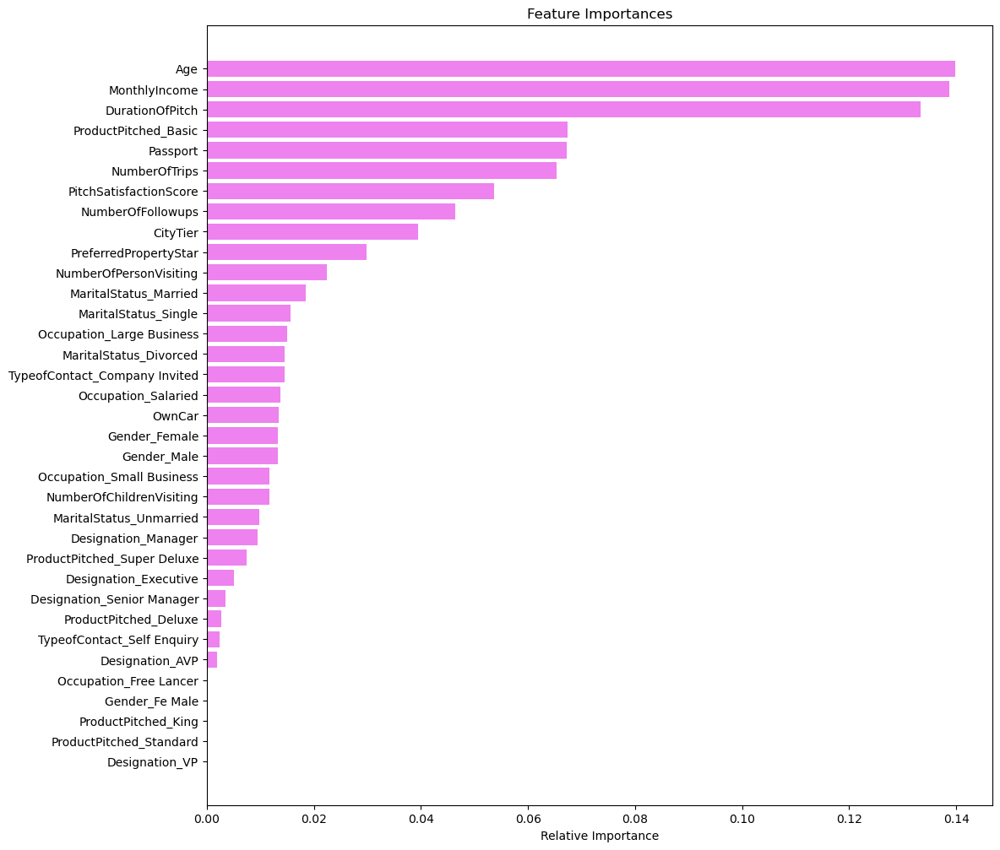

<IPython.core.display.Javascript object>

In [95]:
# Visualize the Gini importances of our features
importances = dTree_ccp.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

* This is probably a good compromise between accuracy and recall, but there's still a some overfitting that leaves a significant gap between test and train recall values.

#### Bagging Performance Summary

In [96]:
# defining list of models
models = [
    bagging_estimator,
    bagging_lr,
    bagging_estimator_tuned,
    rf_estimator,
    rf_estimator_tuned,
    dTree,
    dTree_tuned,
    dTree_ccp,
]

# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []
f1_train = []
f1_test = []

# looping through all the models to get the accuracy, recall, precision, and F1 scores
for model in models:
    j = get_metrics_score(model, False)
    acc_train.append(np.round(j[0], 2))
    acc_test.append(np.round(j[1], 2))
    recall_train.append(np.round(j[2], 2))
    recall_test.append(np.round(j[3], 2))
    precision_train.append(np.round(j[4], 2))
    precision_test.append(np.round(j[5], 2))
    f1_train.append(np.round(j[6], 2))
    f1_test.append(np.round(j[7], 2))

<IPython.core.display.Javascript object>

In [97]:
comparison_frame = pd.DataFrame(
    {
        "Model": [
            "Bagging classifier with default parameters",
            "Bagging classifier with base_estimator=LR",
            "Tuned Bagging Classifier",
            "Random Forest with default parameters",
            "Tuned Random Forest Classifier",
            "Decision Tree with default parameters",
            "Tuned Decision Tree",
            "Post-Pruned Decision Tree",
        ],
        "Train_Accuracy": acc_train,
        "Test_Accuracy": acc_test,
        "Train_Recall": recall_train,
        "Test_Recall": recall_test,
        "Train_Precision": precision_train,
        "Test_Precision": precision_test,
        "Train_F1": f1_train,
        "Test_F1": f1_test,
    }
)
comparison_frame

,Model,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision,Train_F1,Test_F1
0,Bagging classifier with default parameters,0.99,0.90,0.96,0.62,1.00,0.82,0.98,0.70
1,Bagging classifier with base_estimator=LR,0.83,0.83,0.11,0.10,0.91,0.81,0.19,0.17
2,Tuned Bagging Classifier,1.00,0.92,1.00,0.67,1.00,0.90,1.00,0.77
3,Random Forest with default parameters,1.00,0.91,1.00,0.56,1.00,0.93,1.00,0.70
4,Tuned Random Forest Classifier,0.75,0.75,0.65,0.62,0.40,0.40,0.50,0.49
5,Decision Tree with default parameters,1.00,0.89,1.00,0.69,1.00,0.72,1.00,0.70
6,Tuned Decision Tree,0.69,0.67,0.79,0.75,0.36,0.33,0.49,0.46
7,Post-Pruned Decision Tree,1.00,0.88,1.00,0.74,1.00,0.68,1.00,0.71


<IPython.core.display.Javascript object>

### Boosting Models

"Boosting" models adapt and improve with iteration, using various techniques.  We'll explore several boosting models in this section.

#### Adaboost

We'll start with AdaBoost, with the default set of parameters

An AdaBoost classifier is a meta-estimator that begins by fitting a classifier on the original dataset and then fits additional copies of the classifier on the same dataset, but where the weights of incorrectly classified instances are adjusted such that subsequent classifiers focus more on difficult cases.

In [98]:
abc = AdaBoostClassifier(random_state=1)
abc.fit(X_train, y_train)

AdaBoostClassifier(random_state=1)

<IPython.core.display.Javascript object>

In [99]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
abc_score = get_metrics_score(abc)

Accuracy on training set :  0.847682119205298
Accuracy on test set :  0.840701754385965
Recall on training set :  0.34345047923322686
Recall on test set :  0.29850746268656714
Precision on training set :  0.6935483870967742
Precision on test set :  0.6722689075630253
F1 on training set :  0.4594017094017094
F1 on test set :  0.4134366925064599


<IPython.core.display.Javascript object>

In [100]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    abc_score[2] - abc_score[3],
)

Recall score spread between Train and Test data is 0.04494301654665972


<IPython.core.display.Javascript object>

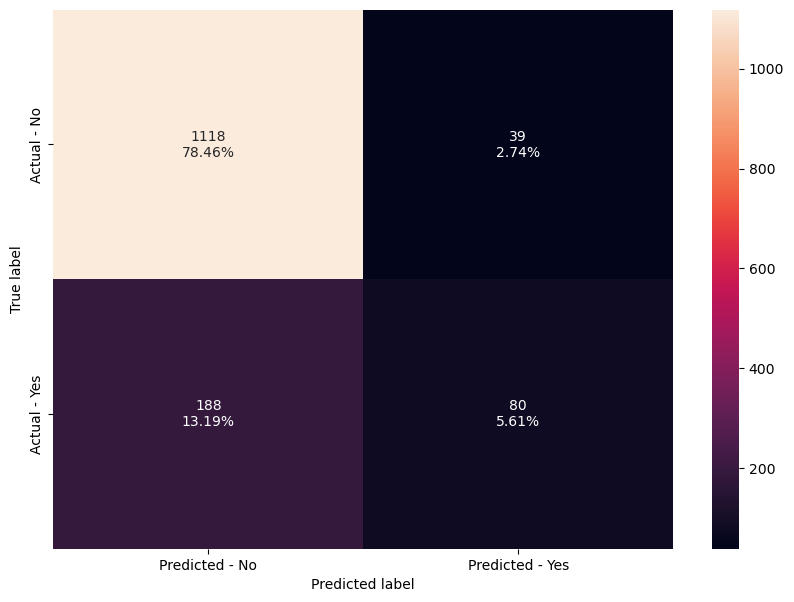

<IPython.core.display.Javascript object>

In [101]:
# Graph the Confusion Matrix
make_confusion_matrix(abc, y_test)

* In general, just really poor accuracy.  The recall spread between train and test is great, but the overall accuracy of the model is poor.

##### Tuned Adaboost

Next we'll try tuning the Adaboost algorithm with a GridSearch.  Some of the critical hyperparameters are:

* base_estimator: The base estimator from which the boosted ensemble is built. 
    * By default the base estimator is a decision tree with max_depth=1
* n_estimators: The maximum number of estimators at which boosting is terminated. 
    * Default value is 50.
* learning_rate: Learning rate shrinks the contribution of each classifier by learning_rate. 
    * There is a trade-off between learning_rate and n_estimators.
    
Parameters like max_depth and class_weight can also be passed in to help overfitting, or to deal with imbalanced classes.

In [102]:
%%time
# Choose the type of classifier. 
abc_tuned = AdaBoostClassifier(random_state=1)

# Grid of parameters 
parameters = {
    #Let's try different max_depth for base_estimator
    "base_estimator":[DecisionTreeClassifier(max_depth=2, random_state=1,class_weight="balanced"),
                      DecisionTreeClassifier(max_depth=3, random_state=1,class_weight="balanced"),
                      DecisionTreeClassifier(max_depth=4, random_state=1,class_weight="balanced")
                     ],
    "n_estimators": np.arange(10,120,10),
    "learning_rate":np.arange(0.1,2,0.1)
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search. Increasing cross-validation gave me a good bump in the results for this dataset
grid_obj = GridSearchCV(abc_tuned, parameters, scoring=acc_scorer,cv=10,n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
abc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
abc_tuned.fit(X_train, y_train)

Wall time: 1min 54s


AdaBoostClassifier(base_estimator=DecisionTreeClassifier(class_weight='balanced',
                                                         max_depth=2,
                                                         random_state=1),
                   learning_rate=0.2, n_estimators=100, random_state=1)

<IPython.core.display.Javascript object>

In [103]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
abc_tuned_score = get_metrics_score(abc_tuned)

Accuracy on training set :  0.829319686935581
Accuracy on test set :  0.8098245614035088
Recall on training set :  0.7971246006389776
Recall on test set :  0.7201492537313433
Precision on training set :  0.531416400425985
Precision on test set :  0.4961439588688946
F1 on training set :  0.6376996805111821
F1 on test set :  0.5875190258751903


<IPython.core.display.Javascript object>

In [104]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    abc_tuned_score[2] - abc_tuned_score[3],
)

Recall score spread between Train and Test data is 0.0769753469076343


<IPython.core.display.Javascript object>

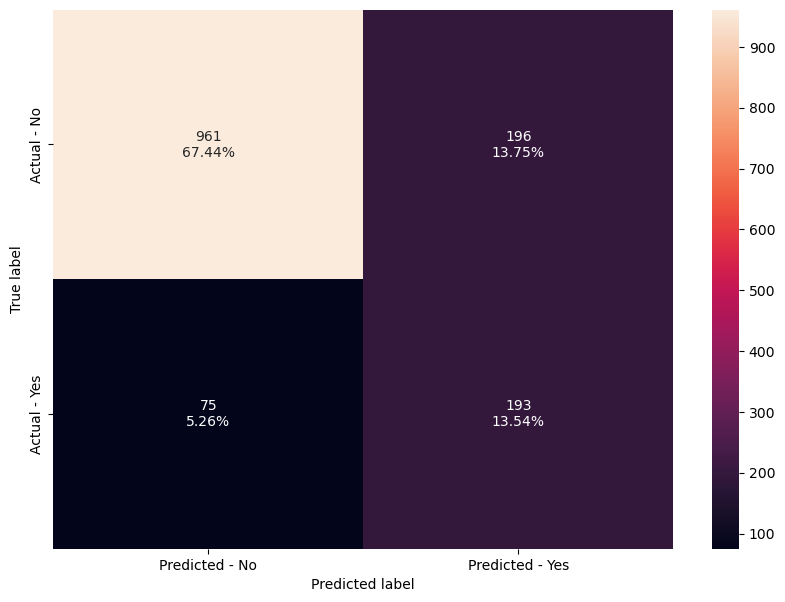

<IPython.core.display.Javascript object>

In [105]:
# Graph the Confusion Matrix
make_confusion_matrix(abc_tuned, y_test)

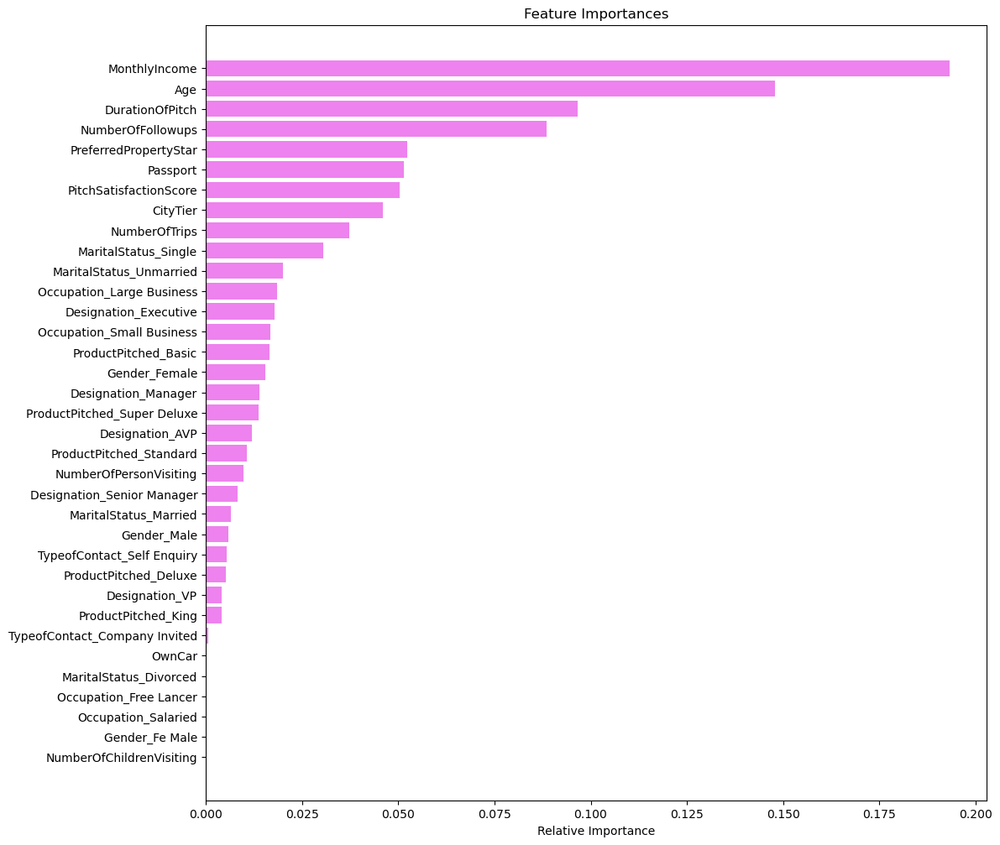

<IPython.core.display.Javascript object>

In [106]:
importances = abc_tuned.feature_importances_
indices = np.argsort(importances)
feature_names = list(X.columns)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

* This is actually pretty good; there's a relatively small split between train and test, and it's not overfitting. 
* Accuracy is above 80%.
* Income, Age, and the effort we spend on the pitch and followups in the sales process are the critical factors here.
* But we still have 5% of our customers we're predicting will not take the package, that would actually take it. Seems like a lot to let slip away.  

Let's see what the other algorithms can do.

#### Gradient Boosting

Next we'll try Gradient Boosting, with the default set of parameters

Gradient boosting iteratively adds decision trees to an ensemble of weak learners, training on the errors of the previous trees. The results are then combined. The "gradient" part of the algorithm is computing the gradient of the loss function with respect to the predictions, and then fitting the new tree on the residual.

In [107]:
gbc = GradientBoostingClassifier(random_state=1)
gbc.fit(X_train, y_train)

GradientBoostingClassifier(random_state=1)

<IPython.core.display.Javascript object>

In [108]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
gbc_score = get_metrics_score(gbc)

Accuracy on training set :  0.8919325707405178
Accuracy on test set :  0.8575438596491228
Recall on training set :  0.48881789137380194
Recall on test set :  0.39925373134328357
Precision on training set :  0.8869565217391304
Precision on test set :  0.7181208053691275
F1 on training set :  0.6302780638516994
F1 on test set :  0.5131894484412469


<IPython.core.display.Javascript object>

In [109]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    gbc_score[2] - gbc_score[3],
)

Recall score spread between Train and Test data is 0.08956416003051837


<IPython.core.display.Javascript object>

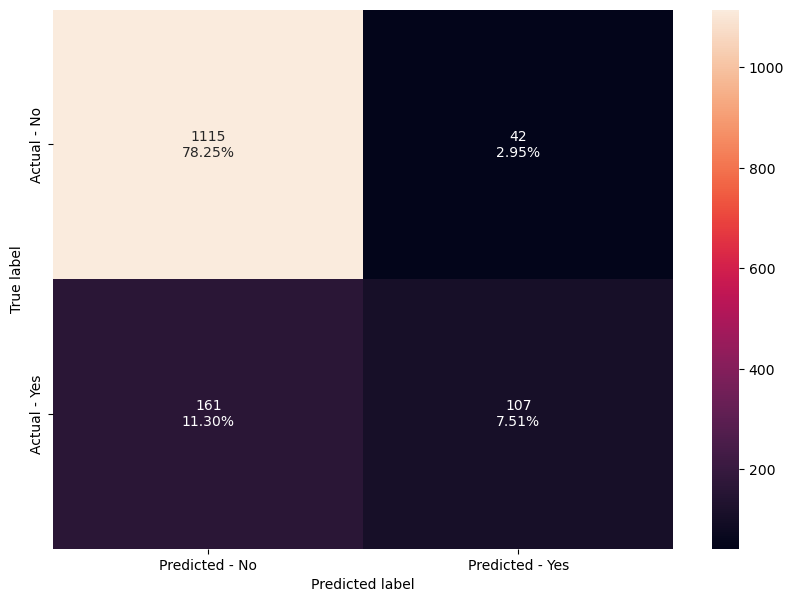

<IPython.core.display.Javascript object>

In [110]:
# Graph the Confusion Matrix
make_confusion_matrix(gbc, y_test)

* Accurate, but poor recall.  This actually gives us better performance for precision, but that's not what we're optimizing for.

##### Tuned Gradient Boosting

Next we'll try tuning our Gradient boosting classifier.

The critical hyperparameters here are:
* Many of the same as random forest classifier.
* init: An estimator object that is used to compute the initial predictions. 
    * If ‘zero’, the initial raw predictions are set to zero. 
    * By default, a DummyEstimator predicting the classes priors is used.

There is no class_weights parameter in gradient boosting.

Our previously trained tuned Adaboost model produced fairly good results.  Let's see if we can improve on those.

In [111]:
# Our gradient boost init score is the previously trained abc_tuned model
gbc_init_score = get_metrics_score(abc_tuned)

Accuracy on training set :  0.829319686935581
Accuracy on test set :  0.8098245614035088
Recall on training set :  0.7971246006389776
Recall on test set :  0.7201492537313433
Precision on training set :  0.531416400425985
Precision on test set :  0.4961439588688946
F1 on training set :  0.6376996805111821
F1 on test set :  0.5875190258751903


<IPython.core.display.Javascript object>

* This is certainly better that our GradientBoosting results with default values
* Since these results are significantly better, we'll use init=abc_tuned to tune our gradient boosting model

In [112]:
%%time
# Choose the type of classifier. 
gbc_tuned = GradientBoostingClassifier(init=abc_tuned,random_state=1)

# Grid of parameters to choose 
parameters = {
    "n_estimators": [600, 800, 1000],
    "subsample":[0.7,0.8,0.9, 1.0], 
    "max_features":[0.2, 0.3, 0.4],
    "learning_rate":[0.0001,0.0005],  
    "max_depth": [7,10,12],
    "min_samples_split": [50,100],
    "min_samples_leaf": [10,20],
    "n_iter_no_change": [5,10, 15], #early stop
    "tol" : [0.0005,0.001] #early stop
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(gbc_tuned, parameters, scoring=acc_scorer,cv=10, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
gbc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
gbc_tuned.fit(X_train, y_train)

Wall time: 2h 4min 58s


GradientBoostingClassifier(init=AdaBoostClassifier(base_estimator=DecisionTreeClassifier(class_weight='balanced',
                                                                                         max_depth=2,
                                                                                         random_state=1),
                                                   learning_rate=0.2,
                                                   n_estimators=100,
                                                   random_state=1),
                           learning_rate=0.0001, max_depth=7, max_features=0.2,
                           min_samples_leaf=10, min_samples_split=50,
                           n_estimators=600, n_iter_no_change=5, random_state=1,
                           subsample=0.7, tol=0.0005)

<IPython.core.display.Javascript object>

In [113]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
gbc_tuned_score = get_metrics_score(gbc_tuned)

Accuracy on training set :  0.827212522576761
Accuracy on test set :  0.8028070175438596
Recall on training set :  0.8067092651757188
Recall on test set :  0.7126865671641791
Precision on training set :  0.5271398747390397
Precision on test set :  0.4835443037974684
F1 on training set :  0.6376262626262627
F1 on test set :  0.5761689291101055


<IPython.core.display.Javascript object>

In [114]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    gbc_tuned_score[2] - gbc_tuned_score[3],
)

Recall score spread between Train and Test data is 0.09402269801153973


<IPython.core.display.Javascript object>

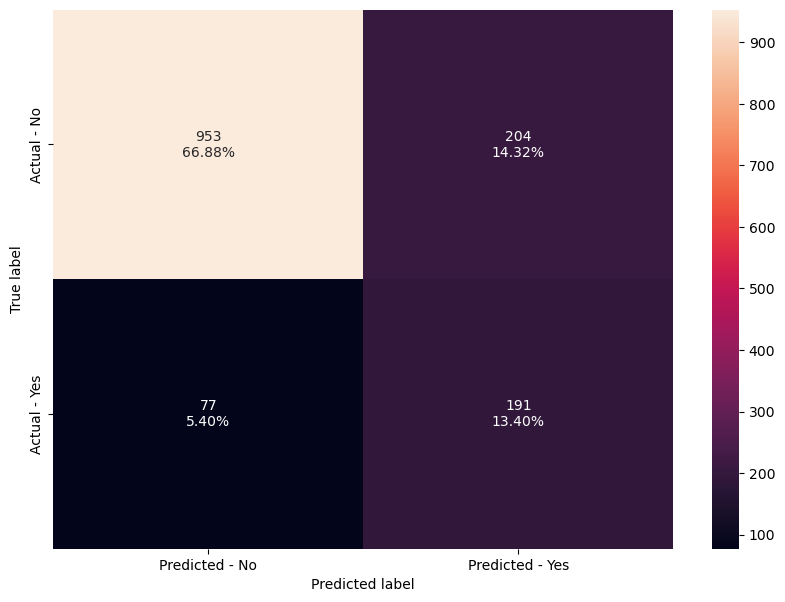

<IPython.core.display.Javascript object>

In [115]:
# Graph the Confusion Matrix
make_confusion_matrix(gbc_tuned, y_test)

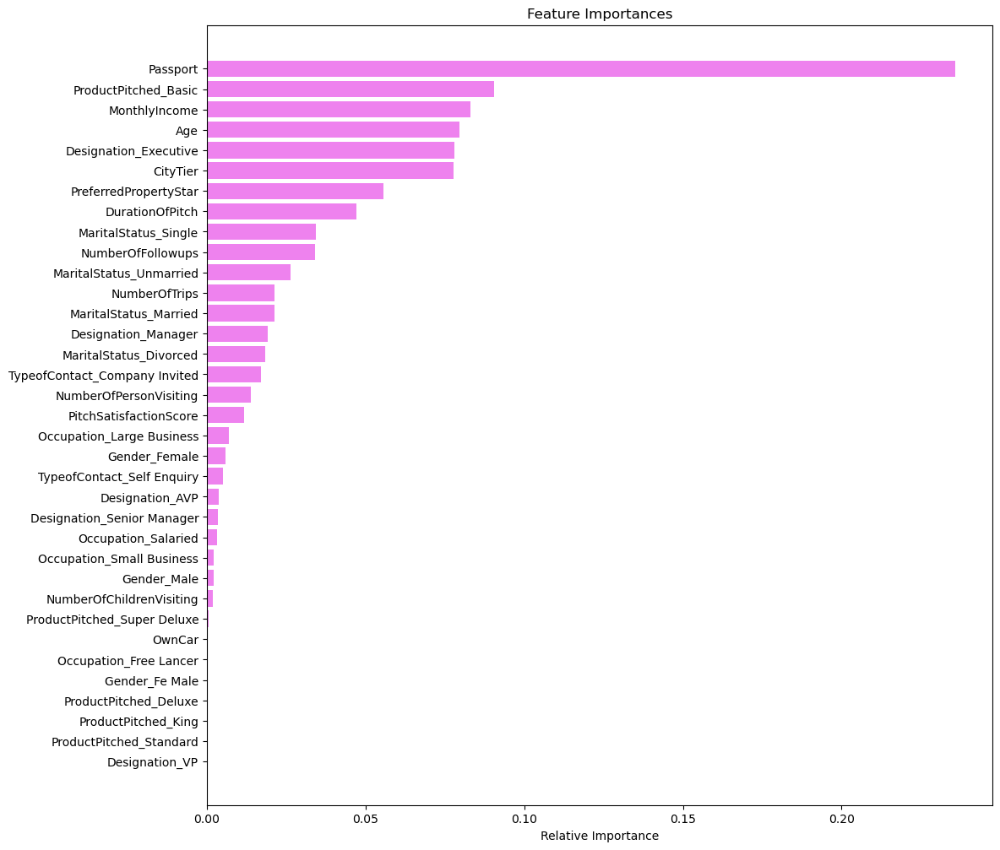

<IPython.core.display.Javascript object>

In [116]:
importances = gbc_tuned.feature_importances_
indices = np.argsort(importances)
feature_names = list(X.columns)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

* I'm not very happy with the way this turned out. 
* Trying to use early stop didn't seem to help it at all.
* Recall on the test set is poor, and the training data is somewhat overfit. 
* I will revisit this as time permits, but I'm not getting good results with Gradient boosting at all
* The feature importances seem to line up with the previous classifiers

#### XGBoost

Let's see what our XGBooosting Classifier produces for us. XGBoost has a rich set of critical parameters: 

* scale_pos_weight:Control the balance of positive and negative weights, useful for unbalanced classes. 
    * It has range from 0 to  ∞
* subsample: Corresponds to the fraction of observations (the rows) to subsample at each step. 
    * By default it is set to 1 meaning that we use all rows.
* colsample_bytree: Corresponds to the fraction of features (the columns) to use.
* colsample_bylevel: The subsample ratio of columns for each level. 
    * Columns are subsampled from the set of columns chosen for the current tree.
* colsample_bynode: The subsample ratio of columns for each node (split). 
    * Columns are subsampled from the set of columns chosen for the current level.
* max_depth: is the maximum number of nodes allowed from the root to the farthest leaf of a tree.
* learning_rate/eta: Makes the model more robust by shrinking the weights on each step.
* gamma: A node is split only when the resulting split gives a positive reduction in the loss function. 
    * Gamma specifies the minimum loss reduction required to make a split.

In [117]:
%%time
# Choose the type of classifier. 
xgb_tuned = XGBClassifier(random_state=1,eval_metric='logloss')

# Grid of parameters to choose from
## add from
parameters = {
    "n_estimators": np.arange(10,200,20),
    "scale_pos_weight":[0,1,2,5],
    "subsample":[0.5,0.7,0.9,1],
    "learning_rate":[0.01,0.1,0.05], #Removed 0.2
    "gamma":[1,3,4], #added 4
    "colsample_bytree":[0.5,0.7,0.9,1],
    "colsample_bylevel":[0.5,0.7,0.9,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(xgb_tuned, parameters,scoring=acc_scorer,cv=5,n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
xgb_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
xgb_tuned.fit(X_train, y_train)

Wall time: 28min 17s


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=0.5, colsample_bynode=None,
              colsample_bytree=0.5, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, gamma=4, gpu_id=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.1, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, n_estimators=30, n_jobs=None,
              num_parallel_tree=None, predictor=None, random_state=1, ...)

<IPython.core.display.Javascript object>

In [118]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
xgb_tuned_score = get_metrics_score(xgb_tuned)

Accuracy on training set :  0.890728476821192
Accuracy on test set :  0.8329824561403508
Recall on training set :  0.9233226837060703
Recall on test set :  0.8022388059701493
Precision on training set :  0.6472564389697648
Precision on test set :  0.5375
F1 on training set :  0.7610269914417379
F1 on test set :  0.6437125748502993


<IPython.core.display.Javascript object>

In [119]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    xgb_tuned_score[2] - xgb_tuned_score[3],
)

Recall score spread between Train and Test data is 0.121083877735921


<IPython.core.display.Javascript object>

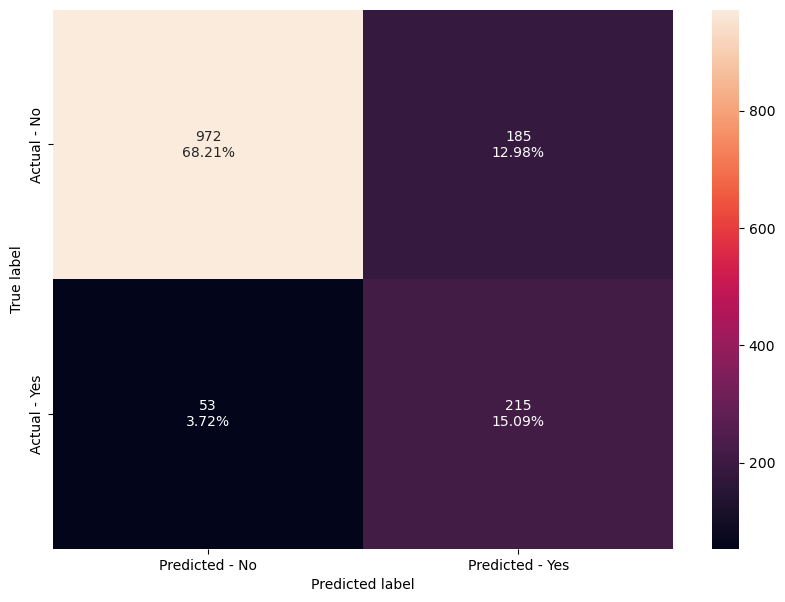

<IPython.core.display.Javascript object>

In [120]:
# Graph the Confusion Matrix
make_confusion_matrix(xgb_tuned, y_test)

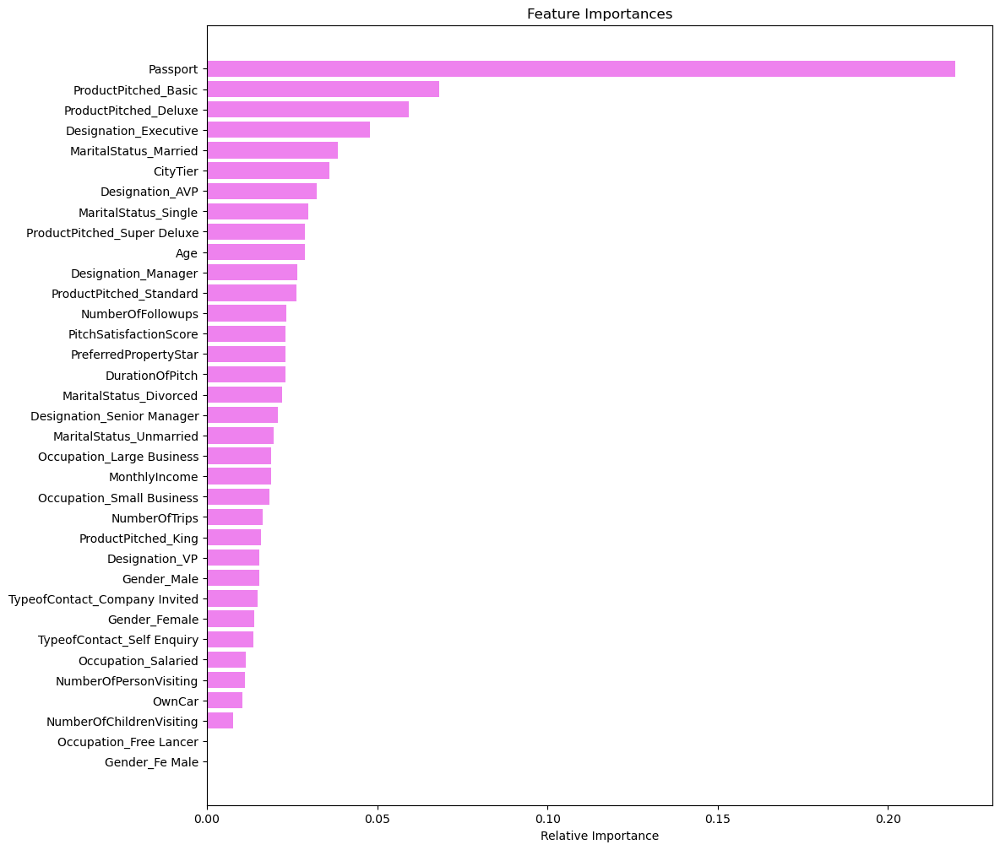

<IPython.core.display.Javascript object>

In [121]:
importances = xgb_tuned.feature_importances_
indices = np.argsort(importances)
feature_names = list(X.columns)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

* What's interesting here is the feature importances with this classifier are completely different
* This is a more balanced result; acceptable accuracy, good (but not overfit) recall on the training data, but a more significant spread on recall with the test data.
* Finally a model with recall above 80%, but I'll continue to iterate as time permits

#### Stacking Classifier

In [122]:
estimators = [
    ("Decision Tree", dTree_tuned),
    ("Random Forest", rf_estimator_tuned),
    ("Gradient Boosting", gbc_tuned),
]
final_estimator = XGBClassifier(random_state=1)

<IPython.core.display.Javascript object>

In [123]:
stacking_estimator = StackingClassifier(
    estimators=estimators, final_estimator=final_estimator, cv=5
)
stacking_estimator.fit(X_train, y_train)

StackingClassifier(cv=5,
                   estimators=[('Decision Tree',
                                DecisionTreeClassifier(class_weight='balanced',
                                                       max_depth=6,
                                                       max_features=0.2,
                                                       min_impurity_decrease=0.001,
                                                       min_samples_leaf=20,
                                                       min_samples_split=15,
                                                       random_state=1)),
                               ('Random Forest',
                                RandomForestClassifier(class_weight='balanced',
                                                       max_depth=4,
                                                       max_features='sqrt',
                                                       max_samples=0.3,
                                                  

<IPython.core.display.Javascript object>

In [124]:
# Using our performance function to get accuracy, recall, precision, and F1 on train and test set
stacking_estimator_score = get_metrics_score(stacking_estimator)

Accuracy on training set :  0.8720650210716436
Accuracy on test set :  0.8343859649122807
Recall on training set :  0.5287539936102237
Recall on test set :  0.4253731343283582
Precision on training set :  0.7180043383947939
Precision on test set :  0.5816326530612245
F1 on training set :  0.6090156393744252
F1 on test set :  0.4913793103448275


<IPython.core.display.Javascript object>

In [125]:
# Quick read on the spread between Recall values
print(
    "Recall score spread between Train and Test data is",
    stacking_estimator_score[2] - stacking_estimator_score[3],
)

Recall score spread between Train and Test data is 0.10338085928186547


<IPython.core.display.Javascript object>

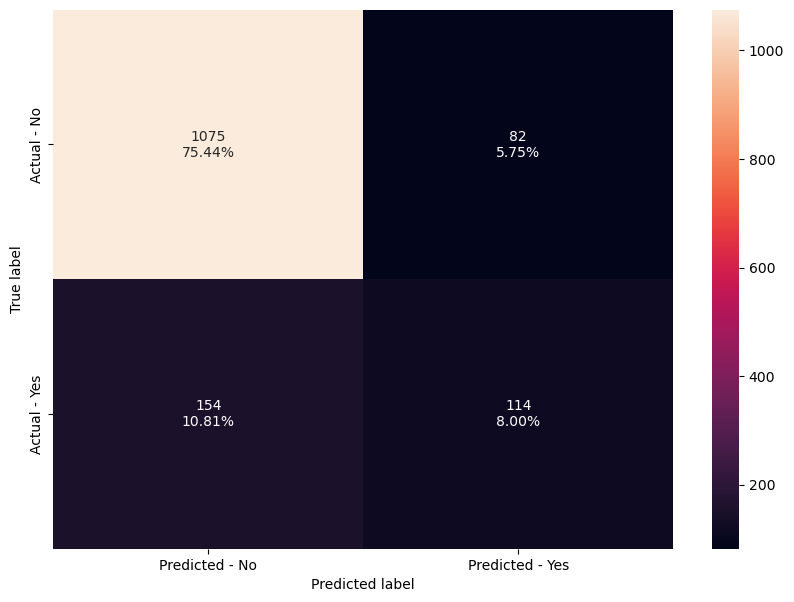

<IPython.core.display.Javascript object>

In [126]:
# Graph the Confusion Matrix
make_confusion_matrix(stacking_estimator, y_test)

#### Boosting Performance Summary

In [127]:
# defining list of models
models = [
    bagging_estimator,
    bagging_lr,
    bagging_estimator_tuned,
    rf_estimator,
    rf_estimator_tuned,
    dTree,
    dTree_tuned,
    dTree_ccp,
    abc,
    abc_tuned,
    gbc,
    gbc_tuned,
    xgb_tuned,
    stacking_estimator,
]

# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []
f1_train = []
f1_test = []

# looping through all the models to get the accuracy, recall, precision, and F1 scores
for model in models:
    j = get_metrics_score(model, False)
    acc_train.append(np.round(j[0], 2))
    acc_test.append(np.round(j[1], 2))
    recall_train.append(np.round(j[2], 2))
    recall_test.append(np.round(j[3], 2))
    precision_train.append(np.round(j[4], 2))
    precision_test.append(np.round(j[5], 2))
    f1_train.append(np.round(j[6], 2))
    f1_test.append(np.round(j[7], 2))

<IPython.core.display.Javascript object>

In [128]:
comparison_frame = pd.DataFrame(
    {
        "Model": [
            "Bagging classifier with default parameters",
            "Bagging classifier with base_estimator=LR",
            "Tuned Bagging Classifier",
            "Random Forest with default parameters",
            "Tuned Random Forest Classifier",
            "Decision Tree with default parameters",
            "Tuned Decision Tree",
            "Post-Pruned Decision Tree",
            "Adaboost classifier with default parameters",
            "Tuned Adaboost Classifier",
            "Gradient Boosting Classifier",
            "Tuned Gradient Boosting Classifier",
            "XGBoosting Classifier",
            "Stacking Estimator",
        ],
        "Train_Accuracy": acc_train,
        "Test_Accuracy": acc_test,
        "Train_Recall": recall_train,
        "Test_Recall": recall_test,
        "Train_Precision": precision_train,
        "Test_Precision": precision_test,
        "Train_F1": f1_train,
        "Test_F1": f1_test,
    }
)
comparison_frame

,Model,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision,Train_F1,Test_F1
0,Bagging classifier with default parameters,0.99,0.90,0.96,0.62,1.00,0.82,0.98,0.70
1,Bagging classifier with base_estimator=LR,0.83,0.83,0.11,0.10,0.91,0.81,0.19,0.17
2,Tuned Bagging Classifier,1.00,0.92,1.00,0.67,1.00,0.90,1.00,0.77
3,Random Forest with default parameters,1.00,0.91,1.00,0.56,1.00,0.93,1.00,0.70
4,Tuned Random Forest Classifier,0.75,0.75,0.65,0.62,0.40,0.40,0.50,0.49
5,Decision Tree with default parameters,1.00,0.89,1.00,0.69,1.00,0.72,1.00,0.70
6,Tuned Decision Tree,0.69,0.67,0.79,0.75,0.36,0.33,0.49,0.46
7,Post-Pruned Decision Tree,1.00,0.88,1.00,0.74,1.00,0.68,1.00,0.71
8,Adaboost classifier with default parameters,0.85,0.84,0.34,0.30,0.69,0.67,0.46,0.41
9,Tuned Adaboost Classifier,0.83,0.81,0.80,0.72,0.53,0.50,0.64,0.59


<IPython.core.display.Javascript object>

## Conclusion and Recommendations

* __Our sales process is siloed to sell specific packages exclusively to specific target audiences.  We should restructure our sales to offer all tiers of packages to all customer types, and let them make the choice about what works best.__
* __Making packages and target customer segements independent would give us the ability to focus on - and tune - the packages that appeal most broadly to the entire customer base.__
* __Based on the success rate of the Super Deluxe package, we're investing more time in the sales cycle for a relatively poor return. We should consider consolidating that package into another, or re-structuring it.__
* __Our win/loss analysis suggests we should focus more on younger travelers, and focus in our second tier cities. We also seem to win more often with invitational or promotional pitches.__
* __We should have some guidance or criteria for sales to abandon a pitch and move on, to avoid spending excessive time on losing pitches.__

__Predictive Model__

* __Our best predictive mode uses the XGBoost classifier, with about 80% recall and 83% accuracy.__


## Appendix: Customer Profile Analysis

#### Basic Package Customer Profile Report
<a id='basic'></a>

In [129]:
customers_basic.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

[Return to Customer Profiles](#profiles)

#### Standard Package Customer Profile Report
<a id='standard'></a>

In [130]:
customers_standard.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

[Return to Customer Profiles](#profiles)

#### Deluxe Package Customer Profile Report
<a id='deluxe'></a>

In [131]:
customers_deluxe.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

[Return to Customer Profiles](#profiles)

#### Super Deluxe Package Customer Profile Report
<a id='super'></a>

In [132]:
customers_super.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

[Return to Customer Profiles](#profiles)

#### King Package Customer Profile Report
<a id='king'></a>

In [133]:
customers_king.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

#### [Return to Customer Profiles](#profiles)